# Capstone Project: Create a Customer Segmentation Report for Arvato Financial Services

In this project, you will analyze demographics data for customers of a mail-order sales company in Germany, comparing it against demographics information for the general population. You'll use unsupervised learning techniques to perform customer segmentation, identifying the parts of the population that best describe the core customer base of the company. Then, you'll apply what you've learned on a third dataset with demographics information for targets of a marketing campaign for the company, and use a model to predict which individuals are most likely to convert into becoming customers for the company. The data that you will use has been provided by our partners at Bertelsmann Arvato Analytics, and represents a real-life data science task.

If you completed the first term of this program, you will be familiar with the first part of this project, from the unsupervised learning project. The versions of those two datasets used in this project will include many more features and has not been pre-cleaned. You are also free to choose whatever approach you'd like to analyzing the data rather than follow pre-determined steps. In your work on this project, make sure that you carefully document your steps and decisions, since your main deliverable for this project will be a blog post reporting your findings.

In [1]:
# import libraries here; add more as necessary
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# magic word for producing visualizations in notebook
%matplotlib inline

# Part 0: Get to Know the Data

There are four data files associated with this project:

- `Udacity_AZDIAS_052018.csv`: Demographics data for the general population of Germany; 891 211 persons (rows) x 366 features (columns).
- `Udacity_CUSTOMERS_052018.csv`: Demographics data for customers of a mail-order company; 191 652 persons (rows) x 369 features (columns).
- `Udacity_MAILOUT_052018_TRAIN.csv`: Demographics data for individuals who were targets of a marketing campaign; 42 982 persons (rows) x 367 (columns).
- `Udacity_MAILOUT_052018_TEST.csv`: Demographics data for individuals who were targets of a marketing campaign; 42 833 persons (rows) x 366 (columns).

Each row of the demographics files represents a single person, but also includes information outside of individuals, including information about their household, building, and neighborhood. Use the information from the first two files to figure out how customers ("CUSTOMERS") are similar to or differ from the general population at large ("AZDIAS"), then use your analysis to make predictions on the other two files ("MAILOUT"), predicting which recipients are most likely to become a customer for the mail-order company.

The "CUSTOMERS" file contains three extra columns ('CUSTOMER_GROUP', 'ONLINE_PURCHASE', and 'PRODUCT_GROUP'), which provide broad information about the customers depicted in the file. The original "MAILOUT" file included one additional column, "RESPONSE", which indicated whether or not each recipient became a customer of the company. For the "TRAIN" subset, this column has been retained, but in the "TEST" subset it has been removed; it is against that withheld column that your final predictions will be assessed in the Kaggle competition.

Otherwise, all of the remaining columns are the same between the three data files. For more information about the columns depicted in the files, you can refer to two Excel spreadsheets provided in the workspace. [One of them](./DIAS Information Levels - Attributes 2017.xlsx) is a top-level list of attributes and descriptions, organized by informational category. [The other](./DIAS Attributes - Values 2017.xlsx) is a detailed mapping of data values for each feature in alphabetical order.

In the below cell, we've provided some initial code to load in the first two datasets. Note for all of the `.csv` data files in this project that they're semicolon (`;`) delimited, so an additional argument in the [`read_csv()`](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.read_csv.html) call has been included to read in the data properly. Also, considering the size of the datasets, it may take some time for them to load completely.

You'll notice when the data is loaded in that a warning message will immediately pop up. Before you really start digging into the modeling and analysis, you're going to need to perform some cleaning. Take some time to browse the structure of the data and look over the informational spreadsheets to understand the data values. Make some decisions on which features to keep, which features to drop, and if any revisions need to be made on data formats. It'll be a good idea to create a function with pre-processing steps, since you'll need to clean all of the datasets before you work with them.

In [2]:
# load in the data
azdias = pd.read_csv('./arvato_data/Udacity_AZDIAS_052018.csv', sep=';')
customers = pd.read_csv('./arvato_data/Udacity_CUSTOMERS_052018.csv', sep=';')

/home/ec2-user/anaconda3/envs/pytorch_latest_p36/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3072: DtypeWarning: Columns (18,19) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


For the sake of minimizing complexity and understanding the data better, we will rename the features columns that are not reflected in DIAS Attributes - Values 2017.xlsx to synchronize the feature columns between the reference table (DIAS Attributes - Values 2017.xlsx) and the fact table (azdias/customers). After renaming, unreferenced columns existing in the fact table would be eventually dropped.

In [3]:
#DROP columns that are not in the reference table DIAS Attributes - Values 2017.xlsx
import difflib

def dropUnreferencedCols(df):
    #read the reference columns
    dias_value_2017 = pd.read_excel("DIAS Attributes - Values 2017.xlsx", engine='openpyxl')
    dias_value_2017.columns = dias_value_2017.iloc[0,:]
    
    #create a list for attribute headers in the dimension table.
    attribute_headers = dias_value_2017.Attribute.dropna().tolist()
    
    #Check if the features in the dimension table exist in the fact table.
    # If not there, append to the list missingcols_facttable.
    missingcols_facttable = []    
    for header in attribute_headers:
        if(header not in list(df)):
            missingcols_facttable.append(header)
            
    print('\n\n')
    
    #Check if the features in the fact table exist in the dimension table.
    #If not there, append to the list missingcols_dimensiontable.
    missingcols_dimensiontable = []
    for header in list(df):
        if(header not in attribute_headers):
            missingcols_dimensiontable.append(header)
            
    """
    Dimension table would be dias_value_2017.
    Fact table would be df.
    
    In the next section, try to match the similarity of column names in the dimension table to the fact table.
    if column is not in the fact table but in the dimension table, raise it as a recommended modification for fact table. 
    This will be stored in the column colname_modifications_1. The tuple appended will be of the format 
    (header, recommended_modification).
    
    If column is not in the dimension table but in the fact table, raise it as a recommended modification for the dimension
    table.
    This will be stored in the column colname_modifications_2. The tuple appended will be of the format 
    (recommended_modification, header).
    
    Now, we will try to come up with the list of modifications to make to the fact table, through intersecting both the lists.
    This will be stored in the column approved_colname_mod which will be used to modify the column names for the fact table.
    
    Finally, modify the data columns for fact table.
    
    Check again if the columns in the fact table are present in the dimension table. If it is not there, drop the column from
    fact table as these are unreferenced columns.
    """
    
    colname_modifications_1 = []
    colname_modifications_2 = []
    
    
    for header in missingcols_dimensiontable:
        if(len(difflib.get_close_matches(header, missingcols_facttable))>0):
            recommended_modification = difflib.get_close_matches(header, missingcols_facttable)[0]
            colname_modifications_1.append((header, recommended_modification))
            
    for header in missingcols_facttable:
        if(len(difflib.get_close_matches(header, missingcols_dimensiontable))>0):
            recommended_modification = difflib.get_close_matches(header, missingcols_dimensiontable)[0]
            colname_modifications_2.append((recommended_modification, header))
            
    
    approved_colname_mod = dict(list(set(colname_modifications_1).intersection(colname_modifications_2)))
    
    new_df = df.rename(columns=approved_colname_mod)
    
    unreferenced_col = []
    for header in list(new_df):
        if(header not in attribute_headers):
            unreferenced_col.append(header)
    
    print("Shape of dataframe before dropping unreferenced columns:  {}".format(new_df.shape) )
    new_df.drop(columns=unreferenced_col, inplace=True)
    print("Shape of dataframe after dropping unreferenced columns:  {}".format(new_df.shape) )
    return new_df, unreferenced_col
    


In [4]:
azdias, unreferenced_col = dropUnreferencedCols(azdias)
print(unreferenced_col)
customers, unreferenced_col =  dropUnreferencedCols(customers)
print(unreferenced_col)




Shape of dataframe before dropping unreferenced columns:  (891221, 366)
Shape of dataframe after dropping unreferenced columns:  (891221, 310)
['LNR', 'AKT_DAT_KL', 'ALTER_KIND1', 'ALTER_KIND2', 'ALTER_KIND3', 'ALTER_KIND4', 'ALTERSKATEGORIE_FEIN', 'ANZ_KINDER', 'ANZ_STATISTISCHE_HAUSHALTE', 'ARBEIT', 'CJT_KATALOGNUTZER', 'CJT_TYP_1', 'CJT_TYP_2', 'CJT_TYP_3', 'CJT_TYP_4', 'CJT_TYP_5', 'CJT_TYP_6', 'D19_KONSUMTYP_MAX', 'D19_LETZTER_KAUF_BRANCHE', 'D19_SOZIALES', 'D19_TELKO_ONLINE_QUOTE_12', 'D19_VERSI_DATUM', 'D19_VERSI_OFFLINE_DATUM', 'D19_VERSI_ONLINE_DATUM', 'D19_VERSI_ONLINE_QUOTE_12', 'EINGEFUEGT_AM', 'EINGEZOGENAM_HH_JAHR', 'EXTSEL992', 'FIRMENDICHTE', 'GEMEINDETYP', 'HH_DELTA_FLAG', 'KBA13_ANTG1', 'KBA13_ANTG2', 'KBA13_ANTG3', 'KBA13_ANTG4', 'KBA13_BAUMAX', 'KBA13_GBZ', 'KBA13_HHZ', 'KBA13_KMH_210', 'KOMBIALTER', 'KONSUMZELLE', 'MOBI_RASTER', 'RT_KEIN_ANREIZ', 'RT_SCHNAEPPCHEN', 'RT_UEBERGROESSE', 'SOHO_KZ', 'STRUKTURTYP', 'UMFELD_ALT', 'UMFELD_JUNG', 'UNGLEICHENN_FLAG', 'VER

# Part 1: Customer Segmentation Report

The main bulk of your analysis will come in this part of the project. Here, you should use unsupervised learning techniques to describe the relationship between the demographics of the company's existing customers and the general population of Germany. By the end of this part, you should be able to describe parts of the general population that are more likely to be part of the mail-order company's main customer base, and which parts of the general population are less so.

## Part 1.1: Analyse the respective datasets.
First, we observe that when reading the datasets, there are issues with datatype consistency within the datasets. These issues are highly implicit as columns with mixed types in Pandas are generally classified to be of an object datatype. We will sort this out through a 3-step approach as outlined in https://medium.com/@dataproducts/pandas-detect-mixed-data-types-and-fix-it-7f0bd3b8d071. 

This involves:
1. Infering column datatypes.
2. Conversion of strings to numbers. For those unable to convert, we will ignore the errors.
3. Finally, we will run a apply function to find out those rows with a string variable.
4. Once we complete the apply function, we will proceed to do value_counts on the specific sets of rows with string type variable, find out what unique values are contained in these columns.

Steps 1-4 would be carried out in __Read_MixedDataTypes__ function accepting a ___DataFrame___ as input

In [5]:
from pandas.api.types import infer_dtype

def Read_MixedDataTypes(df):
    minority_datatype_valdict = {}
    for col in df.columns:
        if(infer_dtype(df[col], skipna=True).split()[0]=='mixed'):
            df.loc[:,col] = df.loc[:,col].apply(lambda x: pd.to_numeric(x, errors = 'ignore'))
            mask = df.loc[:,col].apply(lambda x: isinstance(x, str))
            minority_datatype_val = df.loc[:,col].loc[mask].value_counts()
            print(minority_datatype_val)
            minority_datatype_valdict[col] = minority_datatype_val
    return minority_datatype_valdict



In [6]:
minority_datatype_dict_azdias = Read_MixedDataTypes(azdias)
minority_datatype_dict_customers = Read_MixedDataTypes(customers)

X    373
Name: CAMEO_DEUG_2015, dtype: int64
XX    373
Name: CAMEO_DEUINTL_2015, dtype: int64
X    126
Name: CAMEO_DEUG_2015, dtype: int64
XX    126
Name: CAMEO_DEUINTL_2015, dtype: int64


As seen from the function __ReadMixedDataTypes__ above, there are two 'X' and 'XX' values accounting for mixed dataset issues. Let us look more into what "X" and "XX" mean. 

In [7]:
azdias.loc[(azdias['CAMEO_DEUG_2015']=='X')].head(10)

,AGER_TYP,ALTER_HH,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_PERSONEN,ANZ_TITEL,BALLRAUM,CAMEO_DEU_2015,CAMEO_DEUG_2015,CAMEO_DEUINTL_2015,...,SEMIO_VERT,SHOPPER_TYP,TITEL_KZ,VERS_TYP,W_KEIT_KIND_HH,WOHNDAUER_2008,WOHNLAGE,ZABEOTYP,ANREDE_KZ,ALTERSKATEGORIE_GROB
2511,-1,15.0,1.0,0.0,2.0,0.0,2.0,XX,X,XX,...,4,3,0.0,1,3.0,6.0,2.0,2,2,2
4569,-1,0.0,1.0,0.0,2.0,0.0,7.0,XX,X,XX,...,2,3,0.0,1,3.0,9.0,5.0,2,2,3
9803,2,10.0,1.0,0.0,1.0,0.0,1.0,XX,X,XX,...,3,3,0.0,1,6.0,9.0,3.0,1,2,4
16700,3,0.0,1.0,0.0,2.0,0.0,2.0,XX,X,XX,...,3,2,0.0,2,3.0,9.0,3.0,3,2,3
16883,2,10.0,1.0,0.0,1.0,0.0,2.0,XX,X,XX,...,3,3,0.0,1,6.0,9.0,3.0,4,2,4
22386,-1,19.0,1.0,0.0,1.0,0.0,2.0,XX,X,XX,...,7,1,0.0,1,6.0,3.0,3.0,1,1,2
28123,2,13.0,2.0,0.0,1.0,0.0,2.0,XX,X,XX,...,1,3,0.0,2,3.0,3.0,5.0,6,2,1
31618,-1,0.0,1.0,0.0,2.0,0.0,2.0,XX,X,XX,...,4,3,0.0,2,3.0,6.0,3.0,2,2,3
32864,-1,0.0,0.0,NaN,0.0,0.0,6.0,XX,X,XX,...,4,3,0.0,2,NaN,9.0,2.0,3,2,4
33666,3,0.0,1.0,0.0,2.0,0.0,1.0,XX,X,XX,...,7,1,0.0,2,6.0,9.0,1.0,1,1,3


In [8]:
azdias.loc[(azdias['CAMEO_DEUG_2015']=='XX')].head(10)

,AGER_TYP,ALTER_HH,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_PERSONEN,ANZ_TITEL,BALLRAUM,CAMEO_DEU_2015,CAMEO_DEUG_2015,CAMEO_DEUINTL_2015,...,SEMIO_VERT,SHOPPER_TYP,TITEL_KZ,VERS_TYP,W_KEIT_KIND_HH,WOHNDAUER_2008,WOHNLAGE,ZABEOTYP,ANREDE_KZ,ALTERSKATEGORIE_GROB


In [9]:
azdias.loc[(azdias['CAMEO_DEUINTL_2015']=='X')].head(10)

,AGER_TYP,ALTER_HH,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_PERSONEN,ANZ_TITEL,BALLRAUM,CAMEO_DEU_2015,CAMEO_DEUG_2015,CAMEO_DEUINTL_2015,...,SEMIO_VERT,SHOPPER_TYP,TITEL_KZ,VERS_TYP,W_KEIT_KIND_HH,WOHNDAUER_2008,WOHNLAGE,ZABEOTYP,ANREDE_KZ,ALTERSKATEGORIE_GROB


In [10]:
azdias.loc[(azdias['CAMEO_DEUINTL_2015']=='XX')].head(10)

,AGER_TYP,ALTER_HH,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_PERSONEN,ANZ_TITEL,BALLRAUM,CAMEO_DEU_2015,CAMEO_DEUG_2015,CAMEO_DEUINTL_2015,...,SEMIO_VERT,SHOPPER_TYP,TITEL_KZ,VERS_TYP,W_KEIT_KIND_HH,WOHNDAUER_2008,WOHNLAGE,ZABEOTYP,ANREDE_KZ,ALTERSKATEGORIE_GROB
2511,-1,15.0,1.0,0.0,2.0,0.0,2.0,XX,X,XX,...,4,3,0.0,1,3.0,6.0,2.0,2,2,2
4569,-1,0.0,1.0,0.0,2.0,0.0,7.0,XX,X,XX,...,2,3,0.0,1,3.0,9.0,5.0,2,2,3
9803,2,10.0,1.0,0.0,1.0,0.0,1.0,XX,X,XX,...,3,3,0.0,1,6.0,9.0,3.0,1,2,4
16700,3,0.0,1.0,0.0,2.0,0.0,2.0,XX,X,XX,...,3,2,0.0,2,3.0,9.0,3.0,3,2,3
16883,2,10.0,1.0,0.0,1.0,0.0,2.0,XX,X,XX,...,3,3,0.0,1,6.0,9.0,3.0,4,2,4
22386,-1,19.0,1.0,0.0,1.0,0.0,2.0,XX,X,XX,...,7,1,0.0,1,6.0,3.0,3.0,1,1,2
28123,2,13.0,2.0,0.0,1.0,0.0,2.0,XX,X,XX,...,1,3,0.0,2,3.0,3.0,5.0,6,2,1
31618,-1,0.0,1.0,0.0,2.0,0.0,2.0,XX,X,XX,...,4,3,0.0,2,3.0,6.0,3.0,2,2,3
32864,-1,0.0,0.0,NaN,0.0,0.0,6.0,XX,X,XX,...,4,3,0.0,2,NaN,9.0,2.0,3,2,4
33666,3,0.0,1.0,0.0,2.0,0.0,1.0,XX,X,XX,...,7,1,0.0,2,6.0,9.0,1.0,1,1,3


At a first glance, we observe that the similarity for these rows is that for the rows where the variable ___CAMEO_DEUG_2015___ takes up a value of "X",  ___CAMEO_INTL_2015___ takes up a value of "XX". Interesting :)

When we look at the informational dataset "DIAS Attributes - Values 2017.xlsx", we observe that __CAMEO_INTL_2015__ refers to international classifications of consumers by organisations for planning their sales, marketing and network planning strategies. __CAMEO_DEUG_2015__ on the other hand refers to the local German classifications which as per the informational dataset is mapped to one international code. 

Probably, "X" and "XX" refer to unknown information on these 2 categorical information. It would be best to write a function, therefore, to coerce pd.NaN values within these rows with missing information so that later on the imputation stage, we can use the kNN based algorithmn to correctly impute a more accurate estimate for these missing values.

We will thus, write a function to coerce null values for these rows with "X" and "XX".

We additionally also observe that there are a lot of other values encoded that correspond to unknown data within the dataset. We will proceed to incorporate replacement for those values too.

Here are the steps that will be followed for replacing the respective unknown values in the columns with np.nan:
1. For every feature, find the corresponding value that corresponds to unknown.
2. For that specific column, replace those values with np.nan.
3. Iterate through the remaining columns and return a new dataframe.

In [11]:
def GetValuesToBeReplacedByNAN():
    dias_value_2017 = pd.read_excel("DIAS Attributes - Values 2017.xlsx", engine='openpyxl')
    dias_value_2017.columns = dias_value_2017.iloc[0,:]
    unknown_rows = dias_value_2017[dias_value_2017.Meaning.str.contains('unknown', na=False)]
    unknown_rows.Value = unknown_rows.Value.astype(str) + ','
    unknown_rows = pd.concat([unknown_rows, unknown_rows.Value.str.split(',', expand=True)], axis=1)
    output_list = unknown_rows.loc[:,['Attribute',0,1]]
    return output_list
    
    

def Replace_NAN(df):
    output_list = GetValuesToBeReplacedByNAN()
    
    print(output_list)
    output_list = output_list.dropna(subset=["Attribute"])
    output_list.loc[:,1] = output_list.loc[:,1].replace('', np.nan)
    output_list.loc[:,0] = output_list.loc[:,0].astype(float)
    output_list.loc[:,1] = output_list.loc[:,1].astype(float)
    
    replacement_dict = {}
    for col in output_list.Attribute.tolist():
        sel_row = output_list.loc[output_list.Attribute==col]
        unknown_value1 = sel_row.loc[:,0].values[0]
        unknown_value2 = sel_row.loc[:,1].values[0]
        replacement_dict[col] = {unknown_value1: np.nan, unknown_value2:np.nan}
    df = df.replace(to_replace={'CAMEO_DEUINTL_2015':'XX', 'CAMEO_DEUG_2015':'X'}, value=np.nan)
    df = df.replace(to_replace=replacement_dict)
    return df


    




In [12]:
azdias = Replace_NAN(azdias)
customers = Replace_NAN(customers)

/home/ec2-user/anaconda3/envs/pytorch_latest_p36/lib/python3.6/site-packages/pandas/core/generic.py:5170: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


                 Attribute   0   1
1                 AGER_TYP  -1    
6     ALTERSKATEGORIE_GROB  -1   0
12                ALTER_HH   0    
34               ANREDE_KZ  -1   0
41                BALLRAUM  -1    
...                    ...  ..  ..
2220        WOHNDAUER_2008  -1   0
2230              WOHNLAGE  -1    
2239    WACHSTUMSGEBIET_NB  -1   0
2245        W_KEIT_KIND_HH  -1   0
2252              ZABEOTYP  -1   9

[233 rows x 3 columns]


/home/ec2-user/anaconda3/envs/pytorch_latest_p36/lib/python3.6/site-packages/pandas/core/generic.py:5170: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


                 Attribute   0   1
1                 AGER_TYP  -1    
6     ALTERSKATEGORIE_GROB  -1   0
12                ALTER_HH   0    
34               ANREDE_KZ  -1   0
41                BALLRAUM  -1    
...                    ...  ..  ..
2220        WOHNDAUER_2008  -1   0
2230              WOHNLAGE  -1    
2239    WACHSTUMSGEBIET_NB  -1   0
2245        W_KEIT_KIND_HH  -1   0
2252              ZABEOTYP  -1   9

[233 rows x 3 columns]


## Part 1.2: Outlier Removal
The next phase of the project would be outlier removal. This step would be necessary prior to performing imputation. We will proceed to use the Tukey's method for outlier removal.

According to KDNuggets (https://www.kdnuggets.com/2017/01/3-methods-deal-outliers.html), there are 3 main methods to deal with outlier removal, namely the univariate method, multivariate method and the Minkowski method.

The univariate method such as Tukey's Outlier Removal is chosen for this context rather than multivariate and Minkowski methods as we do not have enough statistical evidence at this juncture to explain the relationship between the various dataset features that is a requirement for multivariate analysis.

### Part 1.2.1: Tukey's Rule for Outlier Removal
The Tukey's Rule for Outlier Removal (https://www.stat.cmu.edu/~cshalizi/statcomp/13/labs/05/lab-05.pdf) defines three quartile ranges (25th percentile (Q1), 50th percentile (Q2) and 75th percentile (Q3)). An outlier is defined as any feature value x, 
that is x <= Q1-1.5* IQR and x >= Q3+1.5* IQR. IQR is defined as Interquartile Range that is IQR=Q3-Q1. 


### Part 1.2.2: Steps for Outlier Removal
In our next part, we will proceed to perform the outlier removal. Outlier removal will be done for discrete data and continuous quantitative data only. As such, we will:

1. Use the datasets to identify features with discrete and continuous data.
2. Perform outlier removal through Tukey's rule.

#### Part 1.2.2.1 Resolving data for numeric values

For finding out the discrete and numeric values, we would make use of the informational dataset __DIAS Attributes - Values 2017.xlsx__ to find out the numeric datacolumns involved. We would explore more into the data values to fix the data inconsistencies, which consists of padding np.nan values or outlier removal.

In [13]:
!pip install openpyxl

In [14]:
!pip install xlrd==1.2.0

In [15]:
def read_informational_datasets():
    dias_value_2017 = pd.read_excel("DIAS Attributes - Values 2017.xlsx", engine='openpyxl')
    dias_value_2017.columns = dias_value_2017.iloc[0,:]
    dias_information_level = pd.read_excel("DIAS Information Levels - Attributes 2017.xlsx", engine='openpyxl')
    dias_information_level.columns = dias_information_level.iloc[0,:]
    return dias_value_2017, dias_information_level

dias_value_2017, dias_information_level = read_informational_datasets()

def read_numeric_val_cols(df, dias_value_ref):
    selected_cols = list(dias_value_ref.loc[dias_value_ref['Meaning'].astype(str).str.contains('numeric')].Attribute.values)
    read_df = df.loc[:,selected_cols]
    return read_df




In [16]:
azdias_numeric = read_numeric_val_cols(azdias, dias_value_2017)
customers_numeric = read_numeric_val_cols(customers, dias_value_2017)

In [17]:
azdias_numeric.head(20)

,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_PERSONEN,ANZ_TITEL,GEBURTSJAHR,KBA13_ANZAHL_PKW,MIN_GEBAEUDEJAHR
0,NaN,NaN,NaN,NaN,0,NaN,NaN
1,11.0,0.0,2.0,0.0,1996,963.0,1992.0
2,10.0,0.0,1.0,0.0,1979,712.0,1992.0
3,1.0,0.0,0.0,0.0,1957,596.0,1997.0
4,3.0,0.0,4.0,0.0,1963,435.0,1992.0
5,5.0,0.0,1.0,0.0,1943,1300.0,1992.0
6,4.0,0.0,1.0,0.0,0,867.0,1992.0
7,6.0,0.0,1.0,0.0,1964,758.0,1992.0
8,2.0,1.0,1.0,0.0,1974,511.0,1992.0
9,9.0,0.0,1.0,0.0,1975,530.0,1992.0


In [18]:
customers_numeric.head(20)

,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_PERSONEN,ANZ_TITEL,GEBURTSJAHR,KBA13_ANZAHL_PKW,MIN_GEBAEUDEJAHR
0,1.0,0.0,2.0,0.0,0,1201.0,1992.0
1,NaN,NaN,3.0,0.0,0,NaN,NaN
2,1.0,0.0,1.0,0.0,0,433.0,1992.0
3,0.0,NaN,0.0,0.0,0,755.0,1992.0
4,7.0,0.0,4.0,0.0,1960,513.0,1992.0
5,1.0,0.0,2.0,0.0,0,1167.0,1992.0
6,1.0,0.0,2.0,0.0,1942,1300.0,1992.0
7,1.0,0.0,2.0,0.0,1938,481.0,1992.0
8,74.0,2.0,1.0,0.0,1914,428.0,1994.0
9,1.0,0.0,3.0,0.0,1959,1106.0,1997.0


Before we do outlier removal, we need to understand further about what these data mean: 

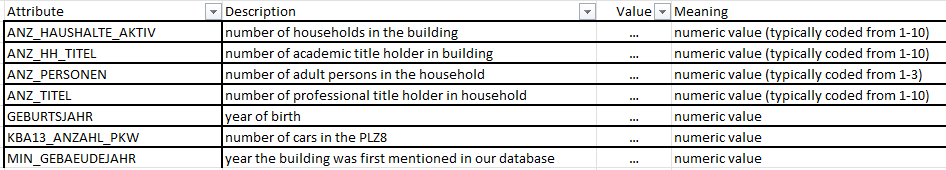

For certain columns such as the years of birth and the year the building was first mentioned in our database, we can convert to time duration through taking difference between the current year and the actual year before proceeding to remove outliers on these columns. The __pad_columns__ function would add these 2 columns.

In [19]:
from datetime import datetime

def pad_columns(numeric_df):
    numeric_df.loc[:,'DURATION_SINCE_BIRTH'] = datetime.now().year-numeric_df['GEBURTSJAHR']
    numeric_df.loc[:,'DURATION_SINCE_BUILDING_MENTION'] = datetime.now().year-numeric_df['MIN_GEBAEUDEJAHR']
    return numeric_df
    
def visualize_boxplot(numeric_df):
    numeric_df = numeric_df.drop(columns=['GEBURTSJAHR', 'MIN_GEBAEUDEJAHR'])
    fig, axes = plt.subplots(3, 3, figsize=(15, 15))
    rowcount=0
    colcount=0
    for col in list(numeric_df):
        ax = sns.boxplot(data=numeric_df[col], ax = axes[rowcount][colcount], orient="h", palette="Set2")
        ax_title = "Boxplot of {}".format(col)
        ax.set_title(ax_title)
        colcount+=1
        if(colcount%3==0):
            rowcount+=1
            colcount=0
    plt.show()
    

Below is the boxplot of azdias numeric dataset visualized. After looking at the spread of values, we observe the column "DURATION_SINCE_BIRTH" has a very wide IQR range. This is not possible and implies there could be data inconsistencies within that column which we have not addressed yet. After looking in further for the top 20 rows, we observe that this is because 'GEBURTSJAHR' column has value '0' for unknown values instead of the regular NaN expression. We will rectify this further in the upcoming analysis.

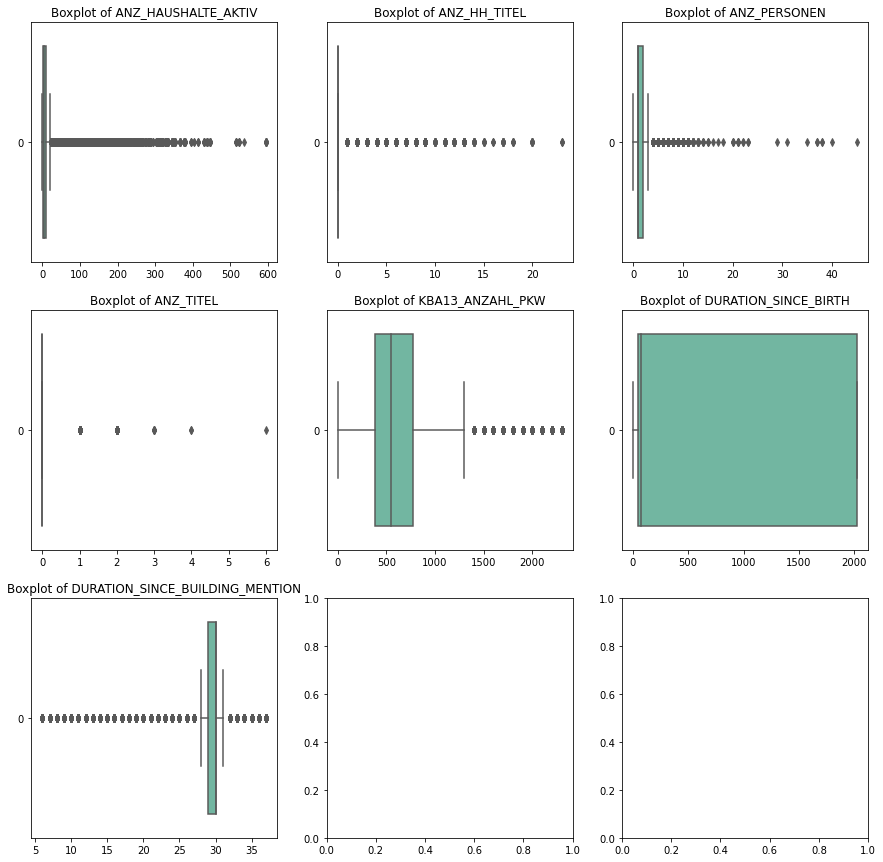

In [20]:
azdias_numeric = pad_columns(azdias_numeric)
visualize_boxplot(azdias_numeric)

In [21]:
azdias_numeric.head(20)

,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_PERSONEN,ANZ_TITEL,GEBURTSJAHR,KBA13_ANZAHL_PKW,MIN_GEBAEUDEJAHR,DURATION_SINCE_BIRTH,DURATION_SINCE_BUILDING_MENTION
0,NaN,NaN,NaN,NaN,0,NaN,NaN,2022,NaN
1,11.0,0.0,2.0,0.0,1996,963.0,1992.0,26,30.0
2,10.0,0.0,1.0,0.0,1979,712.0,1992.0,43,30.0
3,1.0,0.0,0.0,0.0,1957,596.0,1997.0,65,25.0
4,3.0,0.0,4.0,0.0,1963,435.0,1992.0,59,30.0
5,5.0,0.0,1.0,0.0,1943,1300.0,1992.0,79,30.0
6,4.0,0.0,1.0,0.0,0,867.0,1992.0,2022,30.0
7,6.0,0.0,1.0,0.0,1964,758.0,1992.0,58,30.0
8,2.0,1.0,1.0,0.0,1974,511.0,1992.0,48,30.0
9,9.0,0.0,1.0,0.0,1975,530.0,1992.0,47,30.0


The function __FixCol_GEBURTSJAHR__ takes care of this data cleaning through fixing the data inconsistencies within the dataframe consisting of only quantitative values (numeric dataframe) and the original dataframe that it was a subset of. Additionally, within the numeric dataframe, it overwrites the 'DURATION_SINCE_BIRTH' column within the numeric dataframe.

In [22]:
def FixCol_GEBURTSJAHR(numeric_df, original_df):
    #replace 0 values with np.nan
    numeric_df = numeric_df.replace(to_replace={'GEBURTSJAHR':0}, value=np.nan)
    original_df = original_df.replace(to_replace={'GEBURTSJAHR':0}, value=np.nan)
    #in numeric_df, overwrite the DURATION_SINCE_BIRTH values computed previously
    numeric_df.loc[:,'DURATION_SINCE_BIRTH'] = datetime.now().year-numeric_df['GEBURTSJAHR']
    return numeric_df, original_df

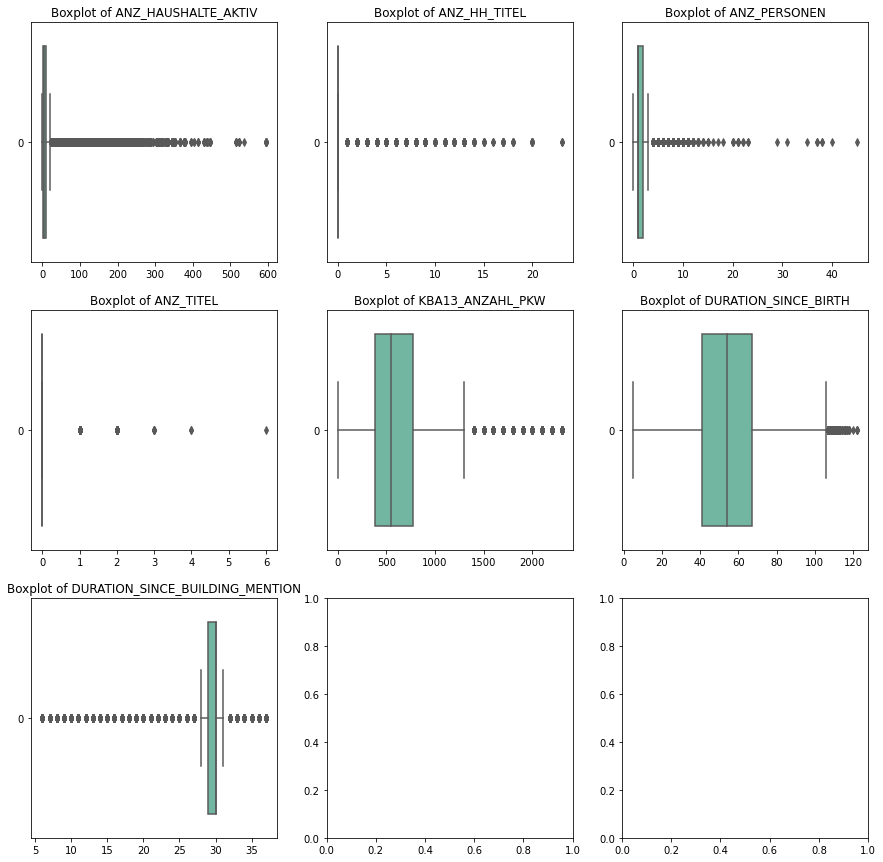

In [23]:
#fix the year column and the computed duration_since_birth column
azdias_numeric, azdias = FixCol_GEBURTSJAHR(azdias_numeric, azdias) 
#replot the boxplot
visualize_boxplot(azdias_numeric)

#### Part 1.2.2.2 Check Numeric Column Eligibility for Outlier Removal

This boxplot looks much better but the quantitative numeric features can be cleaned further as seen from how certain features seems to possess a significant amount of data beyond Tukey's boundaries of Q1-1.5*IQR and Q3+1.5*IQR, where Q1 is the 25th percentile and Q3 is the 75th percentile.

Whilst outlier removal to account for data collection and sampling errors will improve the accuracy of the model, this comes at a tradeoff, whereby the variability of the model is lowered, hence hampering its ability to generalize well to an unseen test data.

To work around this, we will set define a threshold condition whereby at least 95% of data should exist within the Tukey's boundaries of Q1-1.5*IQR and Q1+1.5*IQR before being considered for outlier removal. An implicit assumption here is that errors due to data collection and sampling account for the 5% of outliers that are being removed.

We will define a function __CheckOutlierRemovalEligibility__ to extract the percentage of data values existing within Tukey's boundaries and return to us only numeric features which pass the threshold test.

In [24]:
def CheckOutlierRemovalEligibility(numeric_df, threshold_perc=95):
    numeric_df = numeric_df.drop(columns=['GEBURTSJAHR', 'MIN_GEBAEUDEJAHR'])
    stats = numeric_df.describe()
    Q1 = stats.loc['25%',:]
    Q3 = stats.loc['75%',:]

    IQR_range = Q3-Q1
    tukey_lower = Q1-1.5*IQR_range
    tukey_upper = Q3+1.5*IQR_range
    
    selected_cols = []
    
    for col in list(tukey_lower.index):
        tukey_lower_bound = tukey_lower.loc[col]
        tukey_upper_bound = tukey_upper.loc[col]
        Tukey_range_data = numeric_df.loc[(numeric_df.loc[:,col]>=tukey_lower_bound)&(numeric_df.loc[:,col]<=tukey_upper_bound)].shape[0]
        total_data_len = numeric_df.dropna(subset=[col]).shape[0]
        percent_data_InTukeyrange = (Tukey_range_data/total_data_len)*100.0
        if(percent_data_InTukeyrange>threshold_perc):
            print("{} is eligible for Tukey Outlier Removal, with {:.2f}% of data within Tukey boundaries.".format(col,percent_data_InTukeyrange))
            selected_cols.append(col)
        else:
            print("{} is ineligible for Tukey Outlier Removal, with {:.2f}% of data within Tukey boundaries.".format(col,percent_data_InTukeyrange))
    
    tukey_lowerbounds = tukey_lower.loc[selected_cols]
    tukey_upperbounds = tukey_upper.loc[selected_cols]
    
    return selected_cols, tukey_lowerbounds, tukey_upperbounds   

In [25]:
selected_cols_for_outlier_removal, tukey_lowerbound_for_selcols, tukey_upperbound_for_selcols = CheckOutlierRemovalEligibility(azdias_numeric)

ANZ_HAUSHALTE_AKTIV is ineligible for Tukey Outlier Removal, with 92.64% of data within Tukey boundaries.
ANZ_HH_TITEL is eligible for Tukey Outlier Removal, with 96.98% of data within Tukey boundaries.
ANZ_PERSONEN is ineligible for Tukey Outlier Removal, with 91.46% of data within Tukey boundaries.
ANZ_TITEL is eligible for Tukey Outlier Removal, with 99.61% of data within Tukey boundaries.
KBA13_ANZAHL_PKW is eligible for Tukey Outlier Removal, with 95.32% of data within Tukey boundaries.
DURATION_SINCE_BIRTH is eligible for Tukey Outlier Removal, with 99.95% of data within Tukey boundaries.
DURATION_SINCE_BUILDING_MENTION is ineligible for Tukey Outlier Removal, with 85.07% of data within Tukey boundaries.


#### Part 1.2.2.3 Outlier Removal Process done on selected numeric columns
Once the numeric columns that for outlier removal are selected, we will proceed to perform the actual outlier removal. This is done through the __PerformOutlierRemoval__ function below that takes the original dataframe, selected columns eligible as well as their tukey intervals. The function applies the Tukey boundary conditions on the selected numeric columns and extracts their row indices. These row indices are chosen to filter from the original dataframe on which no prior processing has been done.

In [26]:
def PerformOutlierRemoval(original_df, selected_cols, tukey_lowerbounds, tukey_upperbounds):
    outlier_eligible_df = original_df.reindex(columns = selected_cols)
    indices = []
    
    for col in selected_cols:
        tukey_lower = tukey_lowerbounds[col]
        tukey_upper = tukey_upperbounds[col]
        output_df = outlier_eligible_df.loc[(outlier_eligible_df.loc[:,col]>=tukey_lower)&(outlier_eligible_df.loc[:,col]<=tukey_upper)]
        indices.append(pd.DataFrame(output_df.index.values))
    
    indices_df = pd.concat(indices)
    indices_df = indices_df.drop_duplicates()
    row_indices = indices_df.values.flatten()
    print(row_indices)
    
    original_df = original_df.iloc[row_indices,:]
    original_df.reset_index(drop=True, inplace=True)
    return original_df

In [27]:
azdias = PerformOutlierRemoval(azdias, selected_cols_for_outlier_removal, tukey_lowerbound_for_selcols, tukey_upperbound_for_selcols)

[     1      2      3 ... 890445 890449 891157]


### Part 1.2.3 Creating a Preprocessing Function for Outlier Removal based on Tukey's rules

We will combine all the methods performed for azdias dataset and integrate into a single function, __TukeyOutlierRemoval__, below as follows, which:
1. Pad duration columns to the numeric dataset.
2. Fix data inconsistencies in GEBURTSJAHR column.
3. Visualize a boxplot of the data.
3. Check Outlier Removal Eligibility for columns.
4. Perform Outlier Removal for those numeric columns that are eligible for outlier removal.

In [28]:
def TukeyOutlierRemoval(original_df, numeric_df):
    #Pad duration columns to the numeric dataset
    numeric_df = pad_columns(numeric_df)
    #fix data inconsistencies in GEBURTSJAHR column.
    numeric_df, original_df = FixCol_GEBURTSJAHR(numeric_df, original_df)
    #visualize boxplot of the data
    visualize_boxplot(numeric_df)
    #Check Outlier Removal Eligibility for columns
    selected_cols, tukey_lowerbounds, tukey_upperbounds = CheckOutlierRemovalEligibility(numeric_df, threshold_perc=95)
    #Peform Outlier Removal for the eligible numeric columns
    original_df = PerformOutlierRemoval(original_df, selected_cols, tukey_lowerbounds, tukey_upperbounds)
    return original_df

Applying the __TukeyOutlierRemoval__ function on the customers dataframe.

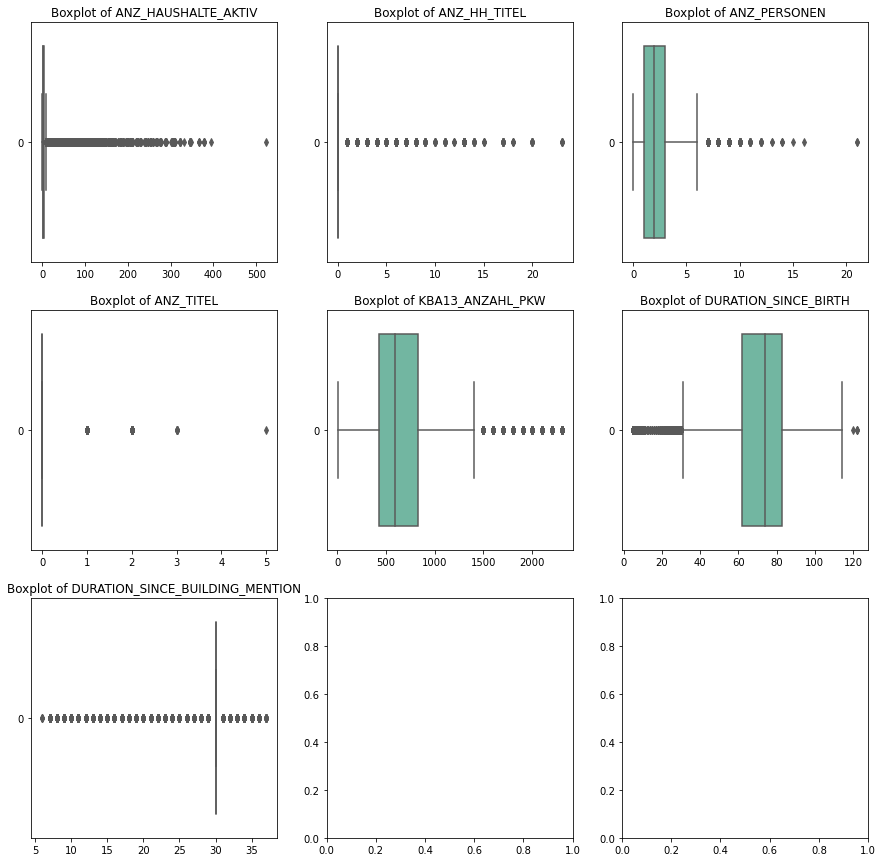

ANZ_HAUSHALTE_AKTIV is ineligible for Tukey Outlier Removal, with 86.66% of data within Tukey boundaries.
ANZ_HH_TITEL is eligible for Tukey Outlier Removal, with 95.64% of data within Tukey boundaries.
ANZ_PERSONEN is eligible for Tukey Outlier Removal, with 99.27% of data within Tukey boundaries.
ANZ_TITEL is eligible for Tukey Outlier Removal, with 98.11% of data within Tukey boundaries.
KBA13_ANZAHL_PKW is eligible for Tukey Outlier Removal, with 96.28% of data within Tukey boundaries.
DURATION_SINCE_BIRTH is eligible for Tukey Outlier Removal, with 99.20% of data within Tukey boundaries.
DURATION_SINCE_BUILDING_MENTION is ineligible for Tukey Outlier Removal, with 75.10% of data within Tukey boundaries.
[     0      2      4 ... 176181 190168 190333]


In [29]:
customers = TukeyOutlierRemoval(customers, customers_numeric)

Displaying the first 20 rows of the dataframe.

In [30]:
customers.head(20)

,AGER_TYP,ALTER_HH,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_PERSONEN,ANZ_TITEL,BALLRAUM,CAMEO_DEU_2015,CAMEO_DEUG_2015,CAMEO_DEUINTL_2015,...,SEMIO_VERT,SHOPPER_TYP,TITEL_KZ,VERS_TYP,W_KEIT_KIND_HH,WOHNDAUER_2008,WOHNLAGE,ZABEOTYP,ANREDE_KZ,ALTERSKATEGORIE_GROB
0,2.0,10.0,1.0,0.0,2.0,0.0,3.0,1A,1.0,13.0,...,6,3.0,NaN,1.0,6.0,9.0,7.0,3,1,4
1,NaN,6.0,1.0,0.0,1.0,0.0,7.0,5D,5.0,34.0,...,3,1.0,NaN,2.0,6.0,9.0,2.0,3,2,4
2,NaN,20.0,7.0,0.0,4.0,0.0,3.0,7B,7.0,41.0,...,5,1.0,NaN,2.0,2.0,9.0,3.0,1,1,3
3,1.0,11.0,1.0,0.0,2.0,0.0,7.0,5D,5.0,34.0,...,7,1.0,NaN,2.0,6.0,9.0,1.0,2,1,3
4,2.0,10.0,1.0,0.0,2.0,0.0,6.0,3B,3.0,23.0,...,6,0.0,NaN,1.0,6.0,9.0,7.0,1,1,4
5,1.0,10.0,1.0,0.0,2.0,0.0,5.0,1D,1.0,15.0,...,7,3.0,NaN,1.0,6.0,9.0,3.0,3,1,4
6,1.0,20.0,1.0,0.0,3.0,0.0,2.0,1D,1.0,15.0,...,7,0.0,NaN,2.0,2.0,9.0,5.0,1,1,3
7,1.0,10.0,1.0,0.0,1.0,0.0,6.0,2D,2.0,14.0,...,7,0.0,NaN,1.0,6.0,3.0,4.0,1,1,4
8,NaN,21.0,1.0,0.0,3.0,0.0,6.0,4A,4.0,22.0,...,6,0.0,NaN,1.0,4.0,9.0,7.0,1,1,4
9,NaN,15.0,1.0,0.0,2.0,0.0,6.0,6B,6.0,43.0,...,7,2.0,NaN,2.0,1.0,9.0,4.0,4,1,3


***

 # Part 1.3: Dealing with columns consisting of high percentage missing data

In the next part of the project, we will be focusing on removing feature columns with a high percentage of missing data. As a general rule of thumb, data would fall into 3 main categories:

    1. Missing at Random - Across a subset of observations, data rows have missing values. Missing data can be predicted based on the observed data.
    2. Missing Completely at Random -  Data is missing across all the observations regardless of the expected value or other variables. Missing data can be removed.
    3. Missing Not Completely at Random - There is a pattern to the subset of missing data. More modelling techniques would be required to understand what attributes external to the dataset could have contributed to such information missing not at random. Whilst studying these might be critical to the 
    
In the next few sections, we will proceed to develop algorithmns to investigate columns with a high percentage of missing data. For the study of missing data, below are the list of data processes that will be undertaken:

1. Finding out the columns with a high percentage of missing data.
2. For the columns with a high percentage of missing data, we will study the extent of correlation of nullability, which will give us insight into whether data is missing at random (MAR) or missing not at random (MNAR).
3. Finally, we will use a dendogram to find out the correlations between the missing data to find out if imputation, listwise removal of rows or column removal will be useful in dealing with the missing data.

First, we will use the __Visualizemissingval__ to plot the barchart of missing data. We will use a threshold percentage of 20% or more to understand columns with a high percentage of missing data.


In [31]:
!python -m pip install matplotlib

In [32]:
import seaborn as sns

def Visualizemissingval(df, threshold):
    missing_perc = df.isnull().sum()/df.shape[0]
    sel_cols = missing_perc.loc[missing_perc>=threshold]
    sel_cols = sel_cols.reset_index().rename(columns={'index':'feature', 0:'percentage_missing'})
    sel_cols.sort_values(by='percentage_missing', ascending=False, inplace=True)
    sns.set(rc={'figure.figsize':(15,10)})
    ax = sns.barplot(x="percentage_missing", y="feature", data=sel_cols)
    return sel_cols



                        feature  percentage_missing
10                     TITEL_KZ            0.997583
0                      AGER_TYP            0.738653
9              D19_KK_KUNDENTYP            0.625038
8                  KBA05_BAUMAX            0.492801
7                   GEBURTSJAHR            0.389834
1                      ALTER_HH            0.289507
2    D19_BANKEN_ONLINE_QUOTE_12            0.224550
3    D19_GESAMT_ONLINE_QUOTE_12            0.224550
4                 D19_KONSUMTYP            0.224550
5                  D19_LOTTO_RZ            0.224550
6   D19_VERSAND_ONLINE_QUOTE_12            0.224550


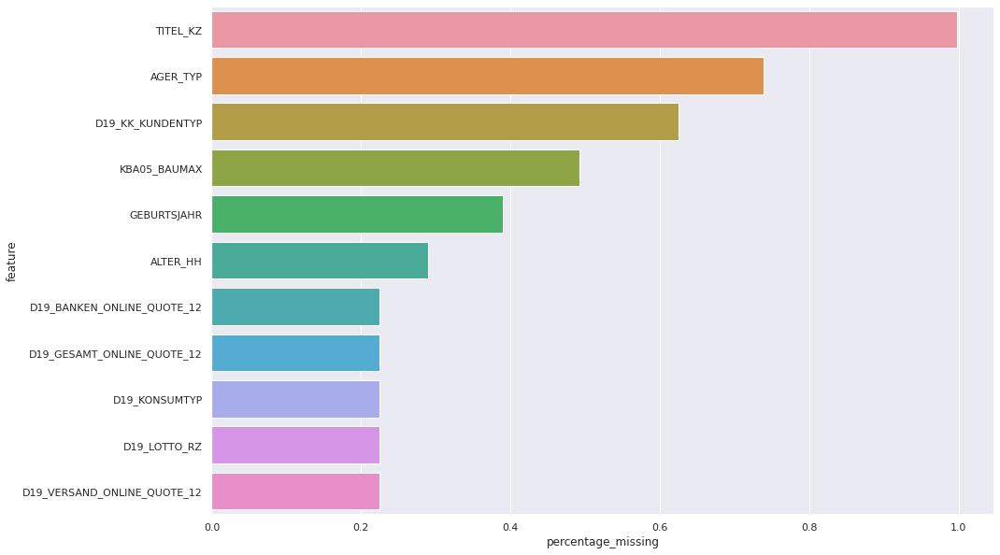

In [33]:
azdias_missing_perc = Visualizemissingval(azdias, threshold=0.2)
print(azdias_missing_perc)

            feature  percentage_missing
4          TITEL_KZ            0.984061
3  D19_KK_KUNDENTYP            0.450449
2      KBA05_BAUMAX            0.433883
1       GEBURTSJAHR            0.320055
0          AGER_TYP            0.313747


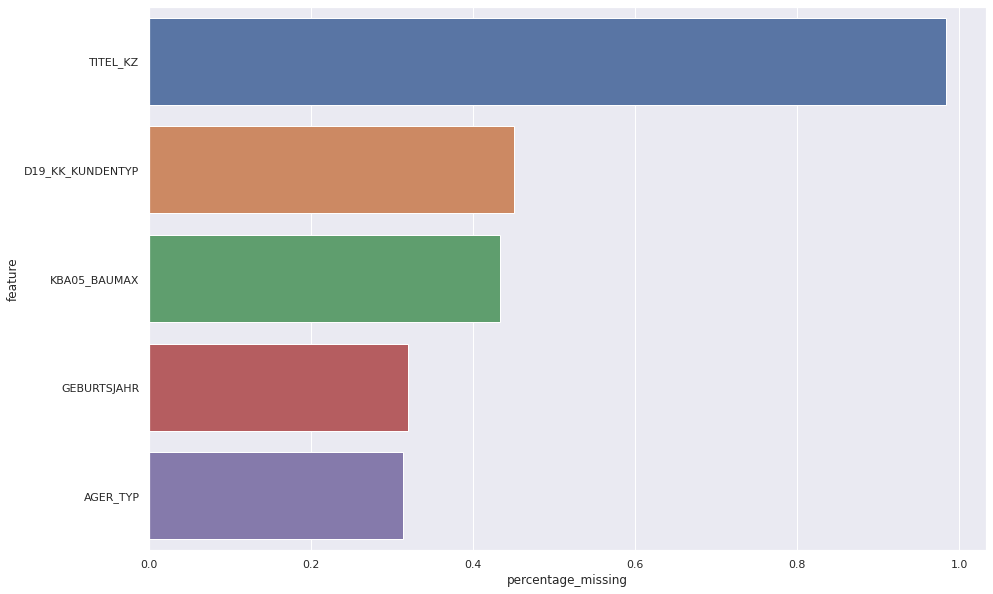

In [34]:
customers_missing_perc = Visualizemissingval(customers, threshold=0.2)
print(customers_missing_perc)

In our examination, we observe that 5 columns in particular have high percentage of missing data in both the customers dataset and the azdias dataset.

- TITEL_KZ column: Flag that shows whether a person holds any academic title.
- D19_KK_KUNDENTYP: Consumption movement in the last 12 months.
- KBA05_BAUMAX: Most common building type within the cell
- GEBURTSJAHR: Year of birth
- AGER_TYP: Best ager-typology (passive elderly/cultural elderly/experience-driven elderly)

We will now study the correlations of nullability in the next section. 

In [35]:
import numpy as np

# df is a pandas.DataFrame instance
def make_nullability_heatmap(df):
    df = df.iloc[:, [i for i, n in enumerate(np.var(df.isnull(), axis='rows')) if n > 0]]
    corr_mat = df.isnull().corr()
    sns.set(rc={'figure.figsize':(250,250)})
    ax = sns.heatmap(corr_mat, annot=True,fmt='.2f')
    return corr_mat


    

In [36]:
corrmat_azdias = make_nullability_heatmap(azdias)

In [37]:
corrmat_customers =  make_nullability_heatmap(customers)

Save the relevant figures to a heatmap directory. In this heatmap generated, most values are generally positively correlated, with the black cells signifying no correlation. We will filter both the nullity correlation dataframes of azdias and customers further to study the nullity correlation of the 5 specific columns with the most missing data.

['TITEL_KZ', 'D19_KK_KUNDENTYP', 'KBA05_BAUMAX', 'GEBURTSJAHR', 'AGER_TYP']
                   Feature  Correlation of TITEL_KZ with feature
0                 TITEL_KZ                              1.000000
1                 AGER_TYP                              0.012563
2      KBA13_HERST_AUDI_VW                              0.008935
3            KBA13_KMH_110                              0.008935
4          KBA13_KMH_0_140                              0.008935
..                     ...                                   ...
222             HEALTH_TYP                             -0.011753
223       NATIONALITAET_KZ                             -0.012326
224  PRAEGENDE_JUGENDJAHRE                             -0.012406
225               ALTER_HH                             -0.014113
226            GEBURTSJAHR                             -0.019394

[227 rows x 2 columns]
                        Feature  Correlation of D19_KK_KUNDENTYP with feature
0              D19_KK_KUNDENTYP           

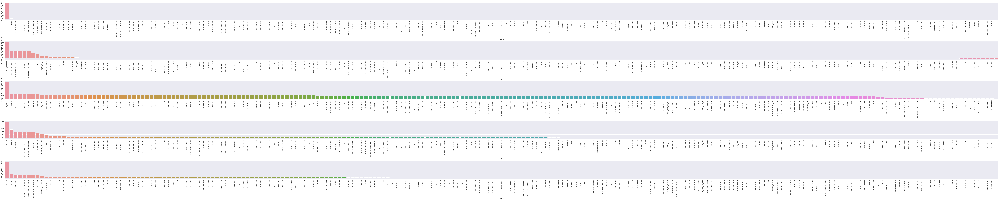

In [38]:
selected_corr = corrmat_azdias.loc[:,['TITEL_KZ','D19_KK_KUNDENTYP','KBA05_BAUMAX','GEBURTSJAHR','AGER_TYP']]
print(list(selected_corr))

fig, axes = plt.subplots(5,1, figsize=(150,30))
i = 0
for col in list(selected_corr):
    sel_col = selected_corr.loc[:,col].sort_values(ascending=False)
    sel_col = sel_col.reset_index()
    sel_col = sel_col.rename(columns={'index':'Feature',col:'Correlation of {} with feature'.format(col)})
    print(sel_col)
    sns.barplot(x="Feature", y='Correlation of {} with feature'.format(col), data=sel_col, ax=axes[i])
    axes[i].set_xticklabels(axes[i].get_xticklabels(),rotation = 90)
    i+=1

fig.tight_layout()
fig.show()

['TITEL_KZ', 'D19_KK_KUNDENTYP', 'KBA05_BAUMAX', 'GEBURTSJAHR', 'AGER_TYP']
            Feature  Correlation of TITEL_KZ with feature
0          TITEL_KZ                              1.000000
1          AGER_TYP                              0.017959
2               KKK                              0.012071
3          REGIOTYP                              0.012071
4      KBA05_KRSZUL                              0.010797
..              ...                                   ...
222    KBA05_BAUMAX                             -0.001651
223  W_KEIT_KIND_HH                             -0.005814
224    ANZ_HH_TITEL                             -0.007527
225        ALTER_HH                             -0.011927
226     GEBURTSJAHR                             -0.025256

[227 rows x 2 columns]
              Feature  Correlation of D19_KK_KUNDENTYP with feature
0    D19_KK_KUNDENTYP                                      1.000000
1         GEBURTSJAHR                                      0.156798


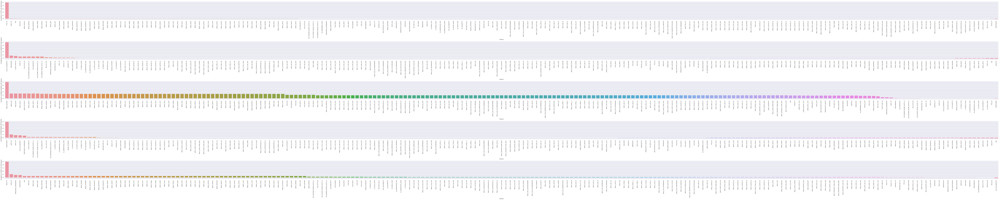

In [39]:
selected_corr = corrmat_customers.loc[:,['TITEL_KZ','D19_KK_KUNDENTYP','KBA05_BAUMAX','GEBURTSJAHR','AGER_TYP']]
print(list(selected_corr))

fig, axes = plt.subplots(5,1, figsize=(150,30))
i = 0
for col in list(selected_corr):
    sel_col = selected_corr.loc[:,col].sort_values(ascending=False)
    sel_col = sel_col.reset_index()
    sel_col = sel_col.rename(columns={'index':'Feature',col:'Correlation of {} with feature'.format(col)})
    print(sel_col)
    sns.barplot(x="Feature", y='Correlation of {} with feature'.format(col), data=sel_col, ax=axes[i])
    axes[i].set_xticklabels(axes[i].get_xticklabels(),rotation = 90)
    i+=1

fig.tight_layout()
fig.show()

From the nullity correlation plot for azdias and customers, it can be observed that at the first glance, the nullability of TITEL_KZ is weakly associated to the nullity of the other features. This could be a likely indicator that data could be completely missing at random or data could be not missing at random (Purposely omitted). We will be required to study the sparsity of the missing data further to decide if this is a variable that could be missing completely at random or not missing at random. 

Whilst comparing the nullity correlation plots between customers and azdias for every feature, a few observations can be made:

- Customers data is a subset of the azdias dataset due to similar patterns in nullability for the features in general.


- The year of birth presents significantly higher correlations of nullability with the other features in the azdias dataset (moderate to stronger) as compared to the customers dataset, with weaker to moderate correlations of nullity. Specifically, for the azdias dataset, the year of birth is not null, whereever information on transactional activity (e.g. D19_LOTTO_RZ, D19_VERSAND_ONLINE_QUOTE_12, etc) is present. This is not true for the customers dataset. Another unique observation is that the AGER_TYPE null value count is lower in the customers dataset than the azdias dataset, which is reflective of an aging population pool within the customers dataset. One possibility could be that younger population would prefer to divulge their year of birth more openly in their transactional activity as compared to the older population.


- In both the datasets, we observe that the feature KBA05_BAUMAX has a higher degree of nullity correlation (moderate to stronger) across with all features. This is a clear indication of values within this column missing at random. Generally, with the exception of TITEL_KZ, the other features are clearly missing at random.


- Transactional patterns in the last 12 months that describes whether a person is a regular buyer/active buyer, etc presents higher nullity correlations with the information on transactional activity similar to year of birth. Why is it that transactional patterns in the last 12 months presents weaker correlations on the customer dataset for these features presenting information on transactional activity in the customers dataset? One possibility could be probably because majority of transactions carried out by the general population in the azdias dataset could be a younger audience carrying out online transactions that contains higher degree of traceability.

In the next section, we will draw dendogram to explain larger relationships within an extremely large dataset that cannot be captured through a heatmap.

In [40]:
!pip install missingno

<AxesSubplot:>

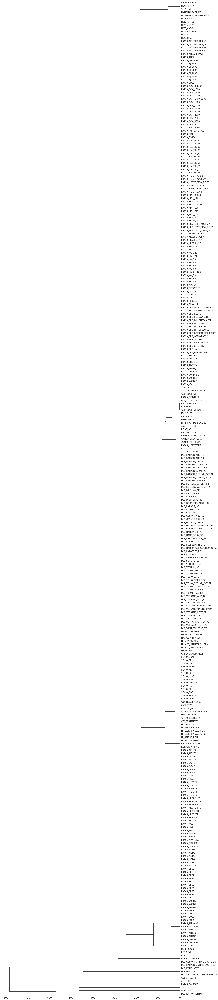

In [41]:
import missingno as msno

msno.dendrogram(azdias)

<AxesSubplot:>

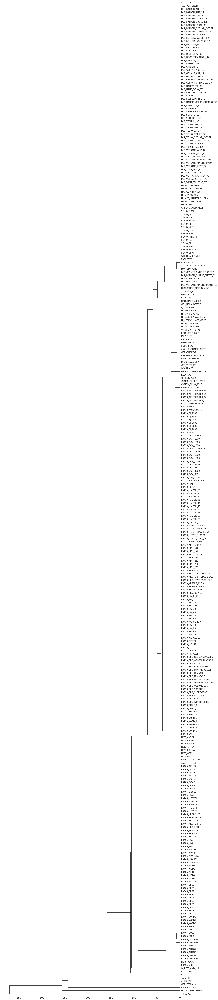

In [42]:
 msno.dendrogram(customers)

The dendograms above illustrate that there is a mismatch of 800 listwise variables for azdias dataset that do not match each other in nullity between the each of the features TITEL_KZ, AGER_TYP and D19_KK_KUNDENTYP and the rest of the features. One more observation is that the columns, "D19_KK_KUNDENTYP" and "TITEL_KZ" have a higher degree of mismatch, followed by "KBA05_BAUMAX", "AGER_TYP" and lastly by "GEBURTSJAHR". To simplify, whilst dropping these columns might improve the correlations of nullity, it might lead to loss of essential information.

Given the information from the dendogram and the nullity correlation heatmap, it has been decided: 

1. The feature "TITEL_KZ" which could have values missing completely at random or not missing at random should be dropped du|e to its lack of influence on the nullity of other features.


2. There could be a listwise drop of the rows across the entire datasets with the more than 5% missing values with null value present in at least one of the columns but not all columns: "D19_KK_KUNDENTYP", "AGER_TYP", "KBA05_BAUMAX" and "GEBURTSJAHR". By doing this, we will eliminate rows with dissimilarity instead of losing critical information through dropping the columns.

In [43]:
def deal_missingdata(df):
    #drop the TITEL_KZ column
    df = df.drop(columns=['TITEL_KZ'])
    
    #filter rows with more than 5% values missing
    sel_df = df.loc[df.isnull().sum(axis=1)/df.shape[1]>0.05]
    
    #select all the rows that have at least 1 missing null value in one of the 4 columns
    sel_df = sel_df.loc[(pd.isna(sel_df.loc[:,"D19_KK_KUNDENTYP"])|(pd.isna(sel_df.loc[:,"AGER_TYP"]))|\
                         (pd.isna(sel_df.loc[:,"KBA05_BAUMAX"]))|(pd.isna(sel_df.loc[:,"GEBURTSJAHR"])))]
    
    #filter out cases where there is a null value in all of these columns which validates the similarity in nullity
    sel_df = sel_df.loc[~(pd.isna(sel_df.loc[:,"D19_KK_KUNDENTYP"])&(pd.isna(sel_df.loc[:,"AGER_TYP"]))&\
                          (pd.isna(sel_df.loc[:,"KBA05_BAUMAX"]))&(pd.isna(sel_df.loc[:,"GEBURTSJAHR"])))]
    
    #sel_df would be the rows that will be dropped from the main dataframe.
    indices_to_drop = sel_df.index.tolist()
    
    #drop the indices from the main dataframe
    df = df.drop(index=indices_to_drop)
    
    return df
                           
                    
                           

In [44]:
azdias = deal_missingdata(azdias)      
customers = deal_missingdata(customers)       

# 1.4 Dealing with Columns that are highly correlated.

To deal with highly correlated columns, we are required to study the degree of association between columns through p-value testing. This test will run a Chi squared test of independence amongst all the feature columns and use a __Cramer's value__ to measure the level of association amongst the feature columns. 

The null hypothesis is that data is not having any associations with other features. Subsequently, the level of significance will be used to reject or accept the hypothesis.

The steps to perform this Chi - squared test is as follows:
- Data preprocessing to remove all the numeric columns and only keeping the categorical variables.
- Creation of a contigency table for the variables with more than 60% missing data and all the categorical variables
- Application of Cramer's logic and Chi - squared testing on our variables to check if the variables are independent.
- Analysis and conclusion of results through test of Independence between the variables.

As defined in https://towardsdatascience.com/statistical-test-for-mcar-in-python-9fb617a76eac, cramer's rule for a contigency columns is as follows.

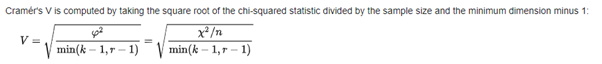

## 1.4.1 Data Preprocessing and contigency table

In [45]:
from scipy.stats import chi2_contingency
import os

def cramerscorrectedstat(contigency_table):
    chi2,p,_,_ = chi2_contingency(contigency_table)
    n = contigency_table.sum().sum()
    phi2 = chi2/n
    r,k = contigency_table.shape
    #this correction is called the bias correction for cramer's corrected statistic.
    phi2corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))
    rcorr = r - ((r-1)**2)/(n-1)
    kcorr = k - ((k-1)**2)/(n-1)
    return np.sqrt(phi2corr/min((kcorr-1),(rcorr-1))), chi2, p
    

def Test_Var_Independence(df, filename):
    if(os.path.exists(os.path.join(os.getcwd(), filename))):
        compared_df = pd.read_csv(os.path.join(os.getcwd(),filename))
    
    else:
        compared_df_cols = ['Feature', 'Feature compared with','p-value','chi-sq value', 'cramer value']
        compared_df_data = []
        i=0
        for col1 in list(df):
            compared_df_col = []
            for col2 in list(df):
                contigency_table = pd.crosstab(index=df[col1], columns=df[col2])
                cramer_val, chi_sq_val, pval = cramerscorrectedstat(contigency_table)
                if(pval<0.05):
                    compared_df_col.append([col1, col2, pval, chi_sq_val, cramer_val])  
            i+=1
            compared_df_data.extend(compared_df_col)
            print("Columns dependent: {}/{}".format(len(compared_df_col),df.shape[1]))
            print("Processed {}/{} columns".format(i, df.shape[1]))
            print("\n")

        compared_df = pd.DataFrame(data = compared_df_data, columns = compared_df_cols)
        #in compared_df, if feature is same as the feature compared with, drop the row as it gives a cramer value of 1.
        compared_df = compared_df.loc[compared_df["Feature"]!=compared_df['Feature compared with']]
        #sort the result by cramer value
        compared_df.sort_values(by='cramer value',ascending=False,inplace=True)
        compared_df.to_csv(os.path.join(os.getcwd(), filename))
    return compared_df     
            

In [46]:
result_table = Test_Var_Independence(azdias, "azdias_cramer_analysis.csv")

Let's look at the result table. The null hypothesisis defined as follows:

__H0 (Null Hypothesis)__: There is no association amongst the columns and the rest of the categorical columns. We will accept/reject the null hypothesis by comparing the p-value against a significance level of 5.0%. 

In other words, if p-value is less than 0.05, we will have the evidence to reject the null hypothesis that there is no association. In fact, these features are dependent. We will add a new boolean column that describes if these features are dependent or independent.

In [47]:
result_table.loc[:,'Independent'] = result_table['p-value'].apply(lambda x: False if x<0.05 else True)
print(result_table)

       Unnamed: 0                   Feature Feature compared with   p-value  \
0           61547         KBA13_HERST_SONST    KBA13_FAB_SONSTIGE  0.000000   
1           55718        KBA13_FAB_SONSTIGE     KBA13_HERST_SONST  0.000000   
2           82796            LP_STATUS_GROB        LP_STATUS_FEIN  0.000000   
3           82488            LP_STATUS_FEIN        LP_STATUS_GROB  0.000000   
4           81556           LP_FAMILIE_GROB       LP_FAMILIE_FEIN  0.000000   
...           ...                       ...                   ...       ...   
94481       65062  KBA13_KRSHERST_FORD_OPEL     D19_BANKEN_ANZ_12  0.037945   
94482       68478               KBA13_KW_50      D19_TELKO_ANZ_12  0.042525   
94483       15796          D19_TELKO_ANZ_12           KBA13_KW_50  0.042525   
94484       54034            KBA13_CCM_2500      D19_TELKO_ANZ_24  0.047250   
94485       16038          D19_TELKO_ANZ_24        KBA13_CCM_2500  0.047250   

       chi-sq value  cramer value  Independent  
0 

We will also create a strength of association based on the cramer's value. To do this, we will proceed to create a column for the strength of association with value thresholds as follows:

- cramer val (>0.8): Nearly Perfect
- cramer val (0.6-0.8): Very Strong
- cramer val (0.5-0.6): Strong
- cramer val (0.4-0.5): Moderate
- cramer val (0.3-0.4): Weak
- cramer val (<0.3): Negligible

In [48]:
def Check_SOA(cramer_val):
    if(cramer_val>0.8):
        return "Nearly Perfect"
    elif(cramer_val>0.6):
        return "Very Strong"
    elif(cramer_val>0.5):
        return "Strong"
    elif(cramer_val>0.4):
        return "Moderate"
    elif(cramer_val>0.3):
        return "Weak"
    else:
        return "Negligible"
        

result_table.loc[:,"Strength of Association"] = result_table.loc[:,'cramer value'].apply(lambda x: Check_SOA(x))
print(result_table)

       Unnamed: 0                   Feature Feature compared with   p-value  \
0           61547         KBA13_HERST_SONST    KBA13_FAB_SONSTIGE  0.000000   
1           55718        KBA13_FAB_SONSTIGE     KBA13_HERST_SONST  0.000000   
2           82796            LP_STATUS_GROB        LP_STATUS_FEIN  0.000000   
3           82488            LP_STATUS_FEIN        LP_STATUS_GROB  0.000000   
4           81556           LP_FAMILIE_GROB       LP_FAMILIE_FEIN  0.000000   
...           ...                       ...                   ...       ...   
94481       65062  KBA13_KRSHERST_FORD_OPEL     D19_BANKEN_ANZ_12  0.037945   
94482       68478               KBA13_KW_50      D19_TELKO_ANZ_12  0.042525   
94483       15796          D19_TELKO_ANZ_12           KBA13_KW_50  0.042525   
94484       54034            KBA13_CCM_2500      D19_TELKO_ANZ_24  0.047250   
94485       16038          D19_TELKO_ANZ_24        KBA13_CCM_2500  0.047250   

       chi-sq value  cramer value  Independent Stre

We will now take the feature values with high percentage of missing data and visualize the data by grouping them by whether they are dependent or independent and strength of association.

The function __VisualizeAssociations__ will help us with grouping the resultant _result table_ dataframe by dependency and association as shown below.

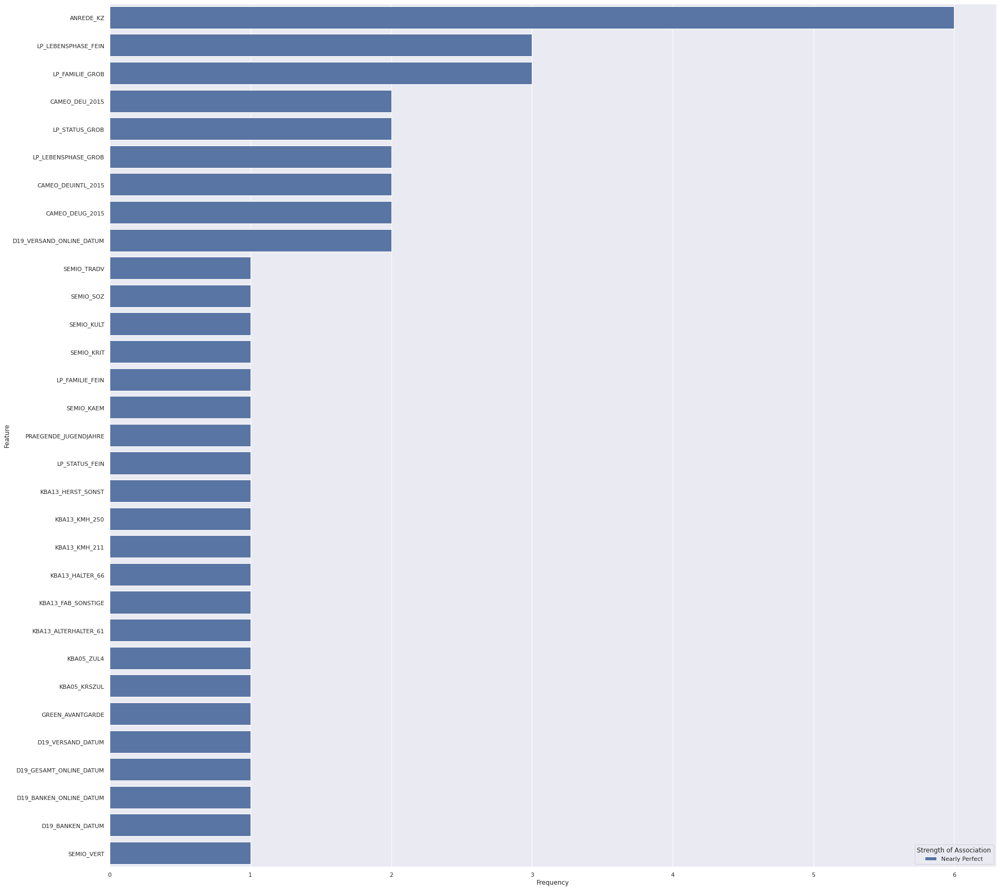

In [49]:
def VisualizeAssociations(df):
    df = df.loc[(df.loc[:,'Strength of Association']=="Nearly Perfect")]
    output_df = df.groupby(by=['Feature', 'Strength of Association', 'Independent']).count()['p-value'].reset_index(drop=False)
    output_df.rename(columns={'p-value':'Frequency'}, inplace=True)
    output_df = output_df.sort_values(by=['Frequency'], ascending=False)
    plt.figure(figsize=(30, 30))
    ax = sns.barplot(x='Frequency', y='Feature', hue='Strength of Association', data=output_df)
    plt.show()
    return output_df

barplot_df = VisualizeAssociations(result_table)

In [50]:
barplot_df

,Feature,Strength of Association,Independent,Frequency
0,ANREDE_KZ,Nearly Perfect,False,6
20,LP_LEBENSPHASE_FEIN,Nearly Perfect,False,3
19,LP_FAMILIE_GROB,Nearly Perfect,False,3
3,CAMEO_DEU_2015,Nearly Perfect,False,2
23,LP_STATUS_GROB,Nearly Perfect,False,2
21,LP_LEBENSPHASE_GROB,Nearly Perfect,False,2
2,CAMEO_DEUINTL_2015,Nearly Perfect,False,2
1,CAMEO_DEUG_2015,Nearly Perfect,False,2
8,D19_VERSAND_ONLINE_DATUM,Nearly Perfect,False,2
29,SEMIO_TRADV,Nearly Perfect,False,1


We will now check for the associated features that cause these features to have nearly perfect associations.

In [51]:
features_associated_w_nearlyperfect = result_table.loc[(result_table['Strength of Association']=="Nearly Perfect")]

In [52]:
features_associated_w_nearlyperfect

,Unnamed: 0,Feature,Feature compared with,p-value,chi-sq value,cramer value,Independent,Strength of Association
0,61547,KBA13_HERST_SONST,KBA13_FAB_SONSTIGE,0.0,2.975268e+06,1.000000,False,Nearly Perfect
1,55718,KBA13_FAB_SONSTIGE,KBA13_HERST_SONST,0.0,2.975268e+06,1.000000,False,Nearly Perfect
2,82796,LP_STATUS_GROB,LP_STATUS_FEIN,0.0,2.996176e+06,0.999997,False,Nearly Perfect
3,82488,LP_STATUS_FEIN,LP_STATUS_GROB,0.0,2.996176e+06,0.999997,False,Nearly Perfect
4,81556,LP_FAMILIE_GROB,LP_FAMILIE_FEIN,0.0,3.745220e+06,0.999996,False,Nearly Perfect
5,81248,LP_FAMILIE_FEIN,LP_FAMILIE_GROB,0.0,3.745220e+06,0.999996,False,Nearly Perfect
6,25943,GREEN_AVANTGARDE,PRAEGENDE_JUGENDJAHRE,0.0,7.253490e+05,0.999991,False,Nearly Perfect
7,86935,PRAEGENDE_JUGENDJAHRE,GREEN_AVANTGARDE,0.0,7.253490e+05,0.999991,False,Nearly Perfect
8,2731,CAMEO_DEUINTL_2015,CAMEO_DEU_2015,0.0,1.485882e+07,0.999985,False,Nearly Perfect
9,2115,CAMEO_DEU_2015,CAMEO_DEUINTL_2015,0.0,1.485882e+07,0.999985,False,Nearly Perfect


Amongst these nearly perfect correlations, we will drop rows with duplicate cramer value. The values existing in the feature column will be removed from the main dataframe subsequently.

In [53]:
Nearlyperfect_features = features_associated_w_nearlyperfect.drop_duplicates(subset=['cramer value']).Feature.tolist()
print("The columns that will be removed from the main dataset would be:\n\n {}".format(Nearlyperfect_features))

The columns that will be removed from the main dataset would be:

 ['KBA13_HERST_SONST', 'LP_STATUS_GROB', 'LP_FAMILIE_GROB', 'LP_FAMILIE_FEIN', 'GREEN_AVANTGARDE', 'CAMEO_DEUINTL_2015', 'CAMEO_DEU_2015', 'LP_LEBENSPHASE_FEIN', 'LP_LEBENSPHASE_GROB', 'LP_FAMILIE_GROB', 'LP_LEBENSPHASE_FEIN', 'ANREDE_KZ', 'LP_LEBENSPHASE_FEIN', 'KBA13_KMH_211', 'KBA13_KMH_250', 'ANREDE_KZ', 'SEMIO_VERT', 'SEMIO_KRIT', 'SEMIO_SOZ', 'ANREDE_KZ', 'D19_VERSAND_ONLINE_DATUM', 'KBA05_KRSZUL', 'D19_GESAMT_ONLINE_DATUM', 'D19_BANKEN_ONLINE_DATUM', 'SEMIO_TRADV', 'CAMEO_DEUINTL_2015', 'CAMEO_DEUG_2015', 'ANREDE_KZ', 'KBA13_ALTERHALTER_61']


We will drop one of the columns in columns with strong correlations from the customers and azdias dataframe through removing every alternate element in the list

In [54]:
Nearlyperfect_features = Nearlyperfect_features[::2]

We will drop one of the columns in columns with strong correlations from the customers and azdias dataframe as shown below through the function __DropNearlyPerfectFeatures__:

In [55]:
def DropNearlyPerfectFeatures(df, Nearlyperfect_features):
    df = df.loc[:,~df.columns.isin(Nearlyperfect_features)]
    print(df.shape)
    return df
    


In [56]:
azdias = DropNearlyPerfectFeatures(azdias, Nearlyperfect_features)
customers = DropNearlyPerfectFeatures(customers, Nearlyperfect_features)

(752792, 295)
(135116, 295)


# 1.5 Label Encoding for columns of type object

Prior to performing data imputation, we would be required to convert the column types of object to numbers to ensure data imputation works.The process is as follows:
1. Identify columns with type object
2. Use a label encoder on those columns and process.
3. Overwrite columns in the original dataset.


In [57]:
sel_col = azdias.loc[:,azdias.apply(lambda col: col.dtype=="object")]

In [58]:
sel_col

,OST_WEST_KZ
0,W
1,W
2,W
3,W
4,W
...,...
817429,O
817430,W
817431,W
817432,W


In [59]:
from sklearn.preprocessing import LabelEncoder

def LabelEncode(df):
    #filter columns with dtype object
    sel_cols = df.loc[:,df.apply(lambda col: col.dtype=="object")]
    print(sel_cols)
    #define Label Encoder
    le = LabelEncoder()
    #fit_transform
    transform_df = pd.DataFrame()
    for col in list(sel_cols):
        print(sel_cols.loc[:, col].values.shape)
        transform_col = le.fit_transform(sel_cols.loc[:, col].values)
        df.loc[:,col] = transform_col
    return df
    


In [60]:
azdias = LabelEncode(azdias)
customers = LabelEncode(customers)

       OST_WEST_KZ
0                W
1                W
2                W
3                W
4                W
...            ...
817429           O
817430           W
817431           W
817432           W
817434           W

[752792 rows x 1 columns]
(752792,)
       OST_WEST_KZ
0                W
1                W
2                W
3                W
4                W
...            ...
145048           W
145049           O
145050           W
145051           W
145052           W

[135116 rows x 1 columns]
(135116,)


# 1.6 Data Imputation 

For the process of data imputation, we will be using a Simple Imputer that has shown promise in its ability to handle missing data for both categorical variables and numeric variables through imputation of the mode and mean respectively. This imputer will take the attributes and methods from the sklearn.impute.SimpleImputer class.

## 1.6.1 Find Numerical and Categorical Columns

The first step would be to find out which features are numerical and which features are categorical. This can be done through cross - referencing with the dimension table (DIAS Information Levels - Attributes 2017.xlsx). For the categorical variables a one hot encoding would be performed prior to passing into a Principal Component Analysis in the next step. As can be seen in the excel file, since most of the features are categorical, we can adopt 'most frequent' as the imputation strategy.

In [61]:
import os
import numpy as np
from sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy="most_frequent")
azdias = pd.DataFrame(imputer.fit_transform(azdias), columns = azdias.columns)
azdias.to_csv(os.path.join(os.getcwd(), "Data_Imputed", "azdias_imputed.csv"), index=False)
customers = pd.DataFrame(imputer.transform(customers), columns = customers.columns)
customers.to_csv(os.path.join(os.getcwd(), "Data_Imputed", "customers_imputed.csv"), index=False)

In [62]:
## UNCOMMENT TO RERUN FROM THIS SECTION ##
#import pandas as pd
#import os

#azdias = pd.read_csv(os.path.join(os.getcwd(), "Data_Imputed", "azdias_imputed.csv"))
#customers = pd.read_csv(os.path.join(os.getcwd(), "Data_Imputed", "customers_imputed.csv"))

# 1.7 Feature Scaling

The next step would be to perform feature scaling on the dataset. This is to normalize the dataset.

In [63]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

scaler.fit(azdias)

azdias = pd.DataFrame(scaler.transform(azdias), columns = azdias.columns)
customers = pd.DataFrame(scaler.transform(customers), columns = customers.columns)

# 1.8 Dimensionality reduction using PCA

## 1.8.1 Introduction to PCA
The PCA is a technique that is used to reduce dimensionality, through selection of features that best explain the variance within the data. One way to select these features is through a method called the scree plot whereby only features that explain up to certain percentage (e.g. 95% variance) are selected as they best explain the relationships within the model.



## 1.8.2 Scree Plot Analysis

In [64]:
customers.shape

(135116, 295)

The scree plot model will only be applied on the customers' dataset to find top n PCA features that capture 98% variance within the dataset capturing buying patterns of the targeted customers. We will not apply it on azdias dataset.

In [65]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import OneHotEncoder

def PCA_fit_transform(df, pca_fit, pca, method, dim_cols):
    print(df.shape)
    features_total = df.shape[1]

    if(method=="fit_transform"):
        if(dim_cols==None):
            pca = PCA(n_components=features_total)
        else:
            pca = PCA(n_components=dim_cols)
        
        pca_fit = pca.fit(df)
    
    df = pca_fit.transform(df)
    PC_values = np.arange(pca.n_components_) + 1
    
    f = plt.figure()
    f.set_figwidth(5)
    f.set_figheight(5)
    plt.title('Scree Plot to explain variances')
    plt.xlabel('Principal Component')
    plt.ylabel('Variance Explained')
    plt.grid(True)
    plt.plot(PC_values, np.cumsum(pca.explained_variance_ratio_), 'o-', linewidth=4, color='green')
    plt.show()
    return pca_fit, pca, df



(752792, 295)


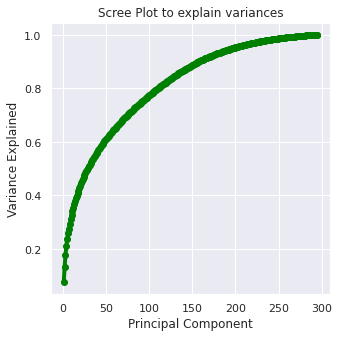

(135116, 295)


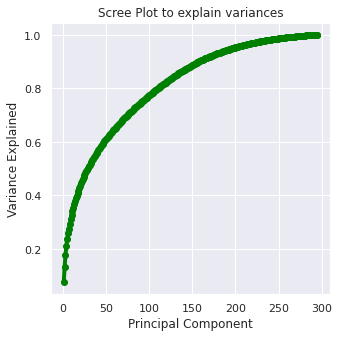

In [66]:
## UNCOMMENT IF RUNNING FOR FIRST TIME ##
pca_fit, pca, azdias = PCA_fit_transform(azdias, pca_fit = None, pca=None, method="fit_transform", dim_cols=None)
## UNCOMMENT IF RERUNNING FROM DATA IMPUTATION TO PREVENT REFITTING. DIRECTLY PERFORM TRANSFORM ##
#pca_fit, pca, azdias_pca = PCA_fit_transform(azdias, pca_fit = pca_fit, pca=pca, method="transform", dim_cols=None)
_,_,customers_pca = PCA_fit_transform(customers, pca_fit = pca_fit, pca=pca, method="transform", dim_cols=None)

In [67]:
pca_elements = len(list(filter(lambda x: x, list(np.cumsum(pca.explained_variance_ratio_)<0.95))))

In [68]:
pca_elements

196

As we can see from the scree plot, about 193 PCA components would be required to explain up to 95% of the variance within the customer dataset. We will incorporate the unsupervised learning on the training dataset and the test dataset. 

We will rerun pca on the azdias and the customers dataset again but this time with the n_components being 193 instead of 287, the original feature size.

(752792, 295)


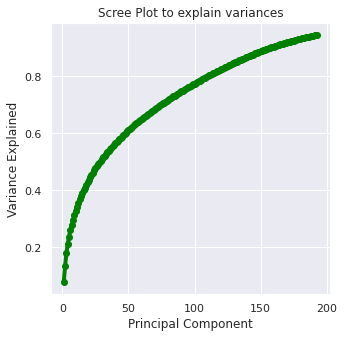

(135116, 295)


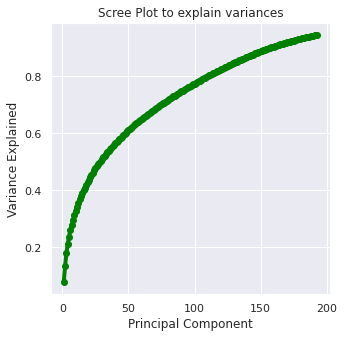

In [69]:
## UNCOMMENT IF RUNNING FOR FIRST TIME ##
pca_fit, pca, azdias_pca = PCA_fit_transform(azdias, pca_fit = None, pca=None, method="fit_transform", dim_cols=193)
## UNCOMMENT IF RERUNNING FROM DATA IMPUTATION TO PREVENT REFITTING. DIRECTLY PERFORM TRANSFORM ##
#pca_fit, pca, azdias_pca = PCA_fit_transform(azdias, pca_fit = pca_fit, pca=pca, method="transform", dim_cols=193)
_,_,customers_pca = PCA_fit_transform(customers, pca_fit = pca_fit, pca=pca, method="transform", dim_cols=193)

# 1.9 K-means elbow test

Finally, we will perform the k-means elbow test to find a knee-point for further dimensionality reduction. K-means clustering is an unsupervised learning technique, that allows the formation of k-nearest clusters for dimensionality reduction. The method involves finding the sum of squared distances from the samples to their nearest cluster center. As the value of k increases, samples tend to form their own clusters and hence the distance tends to 0. 


In [70]:
## DO NOT RERUN THIS SECTION IF YOU ARE RERUNNING FROM DATA IMPUTATION TO PREVENT REFITTING OF KMEANS ##

from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans

def Kmeans_fit(df):
    Sum_of_squared_distances = []
    K = range(1,20)
    for k in K:
        km = KMeans(n_clusters=k)
        km = km.fit(df)
        Sum_of_squared_distances.append(km.inertia_)
        print("Processed for k = {}".format(k))
        
    f = plt.figure()
    f.set_figwidth(5)
    f.set_figheight(5)
    
    
    plt.xlabel('k')
    plt.ylabel('Sum_of_squared_distances')
    plt.title('Elbow Method For Optimal k')
    plt.grid(True)
    
    plt.plot(K, Sum_of_squared_distances, 'o-', linewidth=4, color='green')
    plt.show()



Processed for k = 1
Processed for k = 2
Processed for k = 3
Processed for k = 4
Processed for k = 5
Processed for k = 6
Processed for k = 7
Processed for k = 8
Processed for k = 9
Processed for k = 10
Processed for k = 11
Processed for k = 12
Processed for k = 13
Processed for k = 14
Processed for k = 15
Processed for k = 16
Processed for k = 17
Processed for k = 18
Processed for k = 19


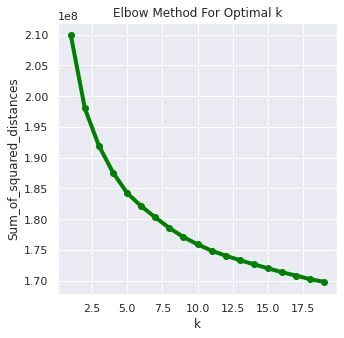

In [71]:
Kmeans_fit(azdias_pca)

Processed for k = 1
Processed for k = 2
Processed for k = 3
Processed for k = 4
Processed for k = 5
Processed for k = 6
Processed for k = 7
Processed for k = 8
Processed for k = 9
Processed for k = 10
Processed for k = 11
Processed for k = 12
Processed for k = 13
Processed for k = 14
Processed for k = 15
Processed for k = 16
Processed for k = 17
Processed for k = 18
Processed for k = 19


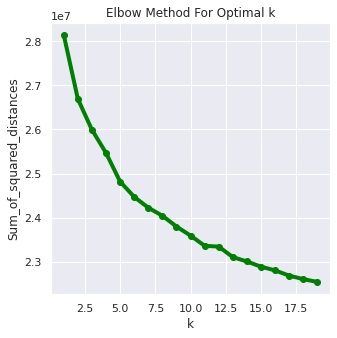

In [72]:
Kmeans_fit(customers_pca)

We observe that at k = 9 and k=12, an elbow inflexion point occurs for both the azdias dataset (less significantly) and customer dataset. We will use this value of 12 to perform transformation on the dataset for azdias and customers datasets to find the cluster.

In [73]:
def Kmeans_fit_transform(df, kmeans_model):
    print(df.shape)
    if(kmeans_model==None):
        kmeans_model = KMeans(n_clusters=12, random_state=0).fit(df)
        print("Model Fitted")
    df = kmeans_model.predict(df)
    return df, kmeans_model

In [74]:
azdias_kmeans, km_model = Kmeans_fit_transform(azdias_pca, kmeans_model=None)
customers_kmeans, _ = Kmeans_fit_transform(customers_pca, kmeans_model=km_model)

(752792, 193)
Model Fitted
(135116, 193)


In [75]:
print("Shape of Azdias after k-means cluster: {}". format(azdias_kmeans.shape))
print("Shape of Customers after k-means cluster: {}". format(customers_kmeans.shape))

Shape of Azdias after k-means cluster: (752792,)
Shape of Customers after k-means cluster: (135116,)


## 1.9.1 Finding out how the over - representation and under - representation of data clusters

    cluster  azdias  customer  azdias_percent  cust_percent
0         0   79877       664           10.61          0.49
1         1   91529     58130           12.16         43.02
2         2   60025      3237            7.97          2.40
3         3   71221     12763            9.46          9.45
4         4   32556         3            4.32          0.00
5         5   86283     47568           11.46         35.21
6         6   47417      3840            6.30          2.84
7         7   44199        40            5.87          0.03
8         8   81119      4286           10.78          3.17
9         9   52855      1077            7.02          0.80
10       10   57846       652            7.68          0.48
11       11   47865      2856            6.36          2.11


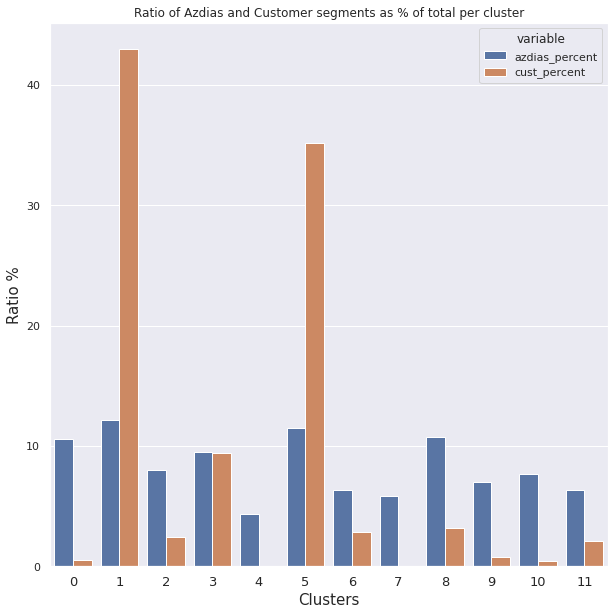

In [76]:
# Count number of predictions for each customer segment
customer_clusters = pd.Series(customers_kmeans)
customer_cluster_count = customer_clusters.value_counts().sort_index()

# Count number in each azdias segment
azdias_clusters = pd.Series(azdias_kmeans)
azdias_cluster_count = azdias_clusters.value_counts().sort_index()

#Concatenate and create new dataframe
df_stat = pd.concat([azdias_cluster_count, customer_cluster_count], axis=1).reset_index()
df_stat.columns = ['cluster','azdias','customer']

# Compare the proportion of data in each cluster for the customer data to the 
# proportion of data in each cluster for the azdias dataset
df_stat.loc[:,'azdias_percent'] = (df_stat.loc[:,'azdias']/df_stat.loc[:,'azdias'].sum()*100).round(2)
df_stat.loc[:,'cust_percent'] = (df_stat.loc[:,'customer']/df_stat.loc[:,'customer'].sum()*100).round(2)
print(df_stat)


#plot as a barplot
df_stat_unpivot = df_stat.melt(id_vars=['cluster','azdias','customer'],\
                               value_vars = ['azdias_percent','cust_percent']).reset_index(drop=True)


f = plt.figure()
f.set_figwidth(10)
f.set_figheight(10)

ax = sns.barplot(x= 'cluster', y = 'value', hue='variable', data=df_stat_unpivot)
ax.set_xlabel('Clusters', fontsize=15) 
ax.set_ylabel('Ratio %', fontsize=15)
ax.tick_params(axis = 'x', which = 'major', labelsize = 13)

plt.title(('Ratio of Azdias and Customer segments as % of total per cluster'))
plt.show()

#save the dataframe to the a csv file for clustering
if(os.path.exists(os.path.join(os.getcwd(), "Kmeans_PCA_clusters"))):
    pass
else:
    os.makedirs(os.path.join(os.getcwd(), "Kmeans_PCA_clusters"))
    

    
df_stat.to_csv(os.path.join(os.getcwd(), "Kmeans_PCA_clusters", "Kmeans_PCA_clusterinfo.csv"), index=False)

As we can see from the graph above, we observe the following:
1. Clusters 1 and 5 are significantly underrepresentative of the customers dataset.

2. Clusters 0,4,7,9 and 10 are significantly overrepresentative of the customers dataset.

In the next step, we will do an inverse transform of these k-mean centroid clusters to get back the weights of main features that contribute to the respective clusters. This will give us insights into the differences between the customer group we are dealing with and the general population of Germany, defined by the azdias dataset.

The function __GetClusterFeature__ will extract a feature dataframe with its original attribute values.


In [77]:
def GetClusterFeature(kmeans_model, pca, standard_scaler, clusters):
    """
    Input:
    kmeans_model: fitted kmeans model
    pca: fitted pca model
    standard_scaler: fitted standard scaler model
    clusters: a list of numerical cluster indices e.g. [0,4,9,11] 
    
    Output:
    returns a dataframe of size (n_feature_columns, n_clusters) where n_feature_columns is given by number of feature columns
    prior to standard scaling and n_clusters is given by length of clusters list.
    """
    scaled_customers = pd.read_csv(os.path.join(os.getcwd(), "Data_Imputed", "customers_imputed.csv"))
    scaled_customers_cols = scaled_customers.columns.tolist()
    
    cluster_centers = pca.inverse_transform(kmeans_model.cluster_centers_)
    cluster_centers_df = pd.DataFrame(cluster_centers, columns=scaled_customers_cols)   
    
    cluster_centers_df.loc[:,scaled_customers_cols] = standard_scaler.inverse_transform(cluster_centers_df.loc[:,scaled_customers_cols])
    return cluster_centers_df.T.loc[:,clusters]
    

In [ ]:
#Get dataframe of feature contribution to clusters
cluster_features_matrix = GetClusterFeature(kmeans_model=km_model,\
                                            pca=pca_fit,\
                                            standard_scaler=scaler,\
                                            clusters=[1,0,4,5,7,9,10])

# We will proceed to take categories with a significant disparity in values for a certain feature.
cluster_features_matrix = cluster_features_matrix.loc[cluster_features_matrix.std(axis=1)>2]

print(cluster_features_matrix)

Summing up all the preprocessing, we will proceed to incorporate the preprocessing steps for the training and test datasets.

In [81]:
import os

def preprocessing(filename, standard_scaler):
    #read the csvfile
    df = pd.read_csv(os.path.join(os.getcwd(), "arvato_data", filename), sep=',')
    
    #seperate the labels from the remaining dataframe
    labels = df[['RESPONSE']]
    df = df.loc[:,~df.columns.isin(["RESPONSE"])]
    
    #for the remaining dataframe,drop the unreferenced column
    df, unreferenced_col = dropUnreferencedCols(df)
    
    #Replace the unknown values to np.nan    
    df = Replace_NAN(df)
    
    #Perform Tukey Outlier Removal
    dias_value_2017, dias_information_level = read_informational_datasets()
    df_numeric = read_numeric_val_cols(df, dias_value_2017)
    df = TukeyOutlierRemoval(df, df_numeric)
    print("Shape of df after outlier removal: {}".format(df.shape))
    
    #deal with missing data which is missing at random/missing completely at random/missing not completely at random
    df = deal_missingdata(df)
    
    #Deal with highly collinear columns through dropping columns to reduce multicollinearity
    result_table = Test_Var_Independence(df = None, filename = "azdias_cramer_analysis.csv")
    result_table.loc[:,'Independent'] = result_table['p-value'].apply(lambda x: False if x<0.05 else True)
    result_table.loc[:,"Strength of Association"] = result_table.loc[:,'cramer value'].apply(lambda x: Check_SOA(x))
    features_associated_w_nearlyperfect = result_table.loc[(result_table['Strength of Association']=="Nearly Perfect")]
    Nearlyperfect_features = features_associated_w_nearlyperfect.drop_duplicates(subset=['cramer value']).Feature.tolist()
    Nearlyperfect_features = Nearlyperfect_features[::2]
    df = DropNearlyPerfectFeatures(df, Nearlyperfect_features)
    
    #Perform label encoding
    df = LabelEncode(df)
    
    #based on the row indices of df, slice from the labels column
    print("Before slicing: {}".format(labels.shape))
    row_indices = df.index.tolist()
    labels = labels.loc[row_indices,:]
    print("After slicing: {}".format(labels.shape))
    
    #Perform simple imputation through most frequent strategy
    imputer = SimpleImputer(strategy="most_frequent")
    df = pd.DataFrame(imputer.fit_transform(df), columns = df.columns)
    
    #Perform feature scaling.
    df = pd.DataFrame(standard_scaler.transform(df), columns = df.columns)
    return df, labels


/home/ec2-user/anaconda3/envs/pytorch_latest_p36/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3263: DtypeWarning: Columns (17,18,19,61,97,317) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):





Shape of dataframe before dropping unreferenced columns:  (42962, 366)
Shape of dataframe after dropping unreferenced columns:  (42962, 310)
                 Attribute   0   1
1                 AGER_TYP  -1    
6     ALTERSKATEGORIE_GROB  -1   0
12                ALTER_HH   0    
34               ANREDE_KZ  -1   0
41                BALLRAUM  -1    
...                    ...  ..  ..
2220        WOHNDAUER_2008  -1   0
2230              WOHNLAGE  -1    
2239    WACHSTUMSGEBIET_NB  -1   0
2245        W_KEIT_KIND_HH  -1   0
2252              ZABEOTYP  -1   9

[233 rows x 3 columns]


/home/ec2-user/anaconda3/envs/pytorch_latest_p36/lib/python3.6/site-packages/pandas/core/generic.py:5170: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


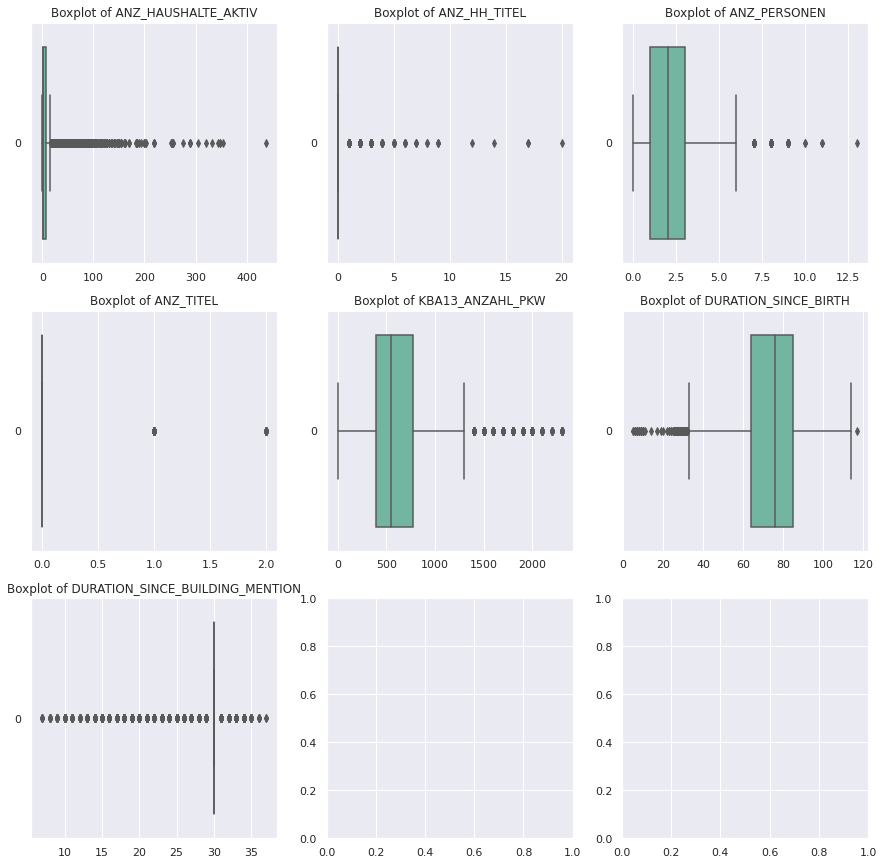

ANZ_HAUSHALTE_AKTIV is ineligible for Tukey Outlier Removal, with 91.50% of data within Tukey boundaries.
ANZ_HH_TITEL is eligible for Tukey Outlier Removal, with 96.54% of data within Tukey boundaries.
ANZ_PERSONEN is eligible for Tukey Outlier Removal, with 99.31% of data within Tukey boundaries.
ANZ_TITEL is eligible for Tukey Outlier Removal, with 99.12% of data within Tukey boundaries.
KBA13_ANZAHL_PKW is eligible for Tukey Outlier Removal, with 95.38% of data within Tukey boundaries.
DURATION_SINCE_BIRTH is eligible for Tukey Outlier Removal, with 98.92% of data within Tukey boundaries.
DURATION_SINCE_BUILDING_MENTION is ineligible for Tukey Outlier Removal, with 73.32% of data within Tukey boundaries.
[    0     1     3 ...  2135  9963 14328]
Shape of df after outlier removal: (25187, 310)
(23864, 295)
      OST_WEST_KZ
0               W
1               W
2               W
3               W
4               W
...           ...
25180           O
25182           O
25183           W

In [82]:
X_train, Y_train = preprocessing('Udacity_MAILOUT_052018_TRAIN.csv',\
                                 scaler)

/home/ec2-user/anaconda3/envs/pytorch_latest_p36/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3263: DtypeWarning: Columns (18,19) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):





Shape of dataframe before dropping unreferenced columns:  (12964, 366)
Shape of dataframe after dropping unreferenced columns:  (12964, 310)


/home/ec2-user/anaconda3/envs/pytorch_latest_p36/lib/python3.6/site-packages/pandas/core/generic.py:5170: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


                 Attribute   0   1
1                 AGER_TYP  -1    
6     ALTERSKATEGORIE_GROB  -1   0
12                ALTER_HH   0    
34               ANREDE_KZ  -1   0
41                BALLRAUM  -1    
...                    ...  ..  ..
2220        WOHNDAUER_2008  -1   0
2230              WOHNLAGE  -1    
2239    WACHSTUMSGEBIET_NB  -1   0
2245        W_KEIT_KIND_HH  -1   0
2252              ZABEOTYP  -1   9

[233 rows x 3 columns]


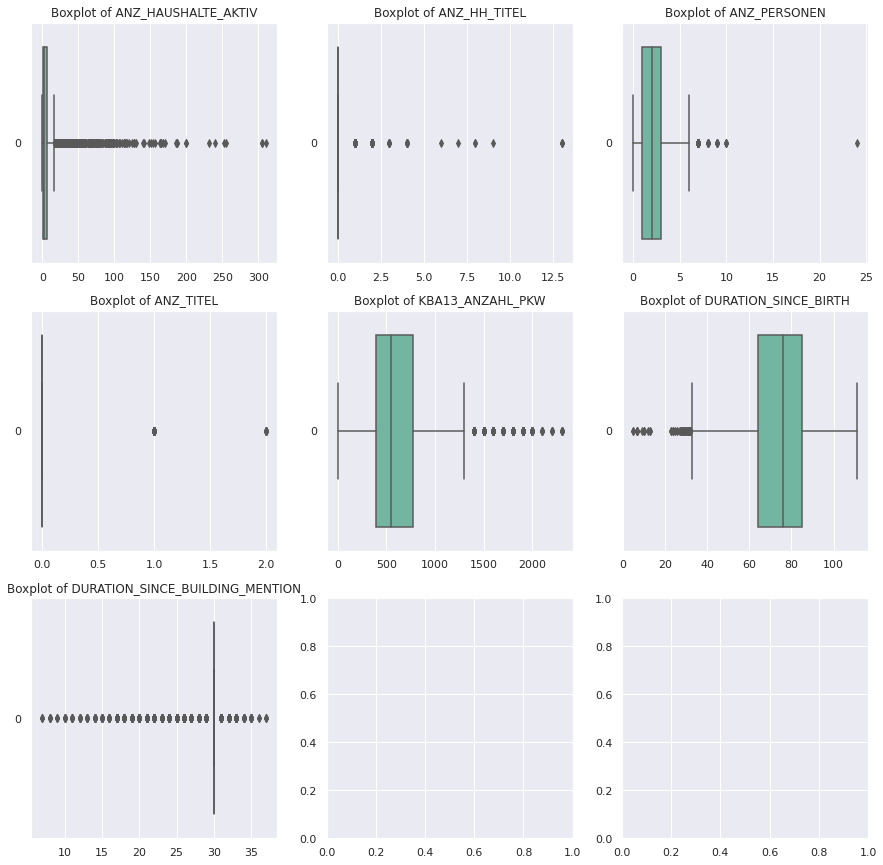

ANZ_HAUSHALTE_AKTIV is ineligible for Tukey Outlier Removal, with 91.29% of data within Tukey boundaries.
ANZ_HH_TITEL is eligible for Tukey Outlier Removal, with 96.26% of data within Tukey boundaries.
ANZ_PERSONEN is eligible for Tukey Outlier Removal, with 99.44% of data within Tukey boundaries.
ANZ_TITEL is eligible for Tukey Outlier Removal, with 99.10% of data within Tukey boundaries.
KBA13_ANZAHL_PKW is eligible for Tukey Outlier Removal, with 95.06% of data within Tukey boundaries.
DURATION_SINCE_BIRTH is eligible for Tukey Outlier Removal, with 98.83% of data within Tukey boundaries.
DURATION_SINCE_BUILDING_MENTION is ineligible for Tukey Outlier Removal, with 73.71% of data within Tukey boundaries.
[    0     1     2 ... 12930 12942  7573]
Shape of df after outlier removal: (10806, 310)
(10200, 295)
      OST_WEST_KZ
0               W
1               W
2               W
3               W
4               W
...           ...
10798           O
10800           W
10802           W

In [84]:
X_test, Y_test = preprocessing('Udacity_MAILOUT_052018_TEST.csv',\
                                 scaler)

In [85]:
print("X_train: {}".format(X_train.shape))
print("X_test: {}".format(X_test.shape))
print("Y_train: {}".format(Y_train.shape))
print("Y_test: {}".format(Y_test.shape))


X_train: (23864, 295)
X_test: (10200, 295)
Y_train: (23864, 1)
Y_test: (10200, 1)


In [87]:
#save the training, test dataset and labels to the local directory

#This will be the storage location for the training, test and validation datasets.
if(not os.path.exists(os.path.join(os.getcwd(), "Data"))):
    os.makedirs(os.path.join(os.getcwd(), "Data"))

pd.DataFrame(X_train).to_csv(os.path.join(os.getcwd(), "Data","train_X.csv"), index=False)
pd.DataFrame(Y_train).to_csv(os.path.join(os.getcwd(), "Data","train_Y.csv"), index=False)

pd.DataFrame(X_test).to_csv(os.path.join(os.getcwd(), "Data","test_X.csv"), index=False)
pd.DataFrame(Y_test).to_csv(os.path.join(os.getcwd(), "Data","test_Y.csv"), index=False)

Proceed to open up the notebook on supervised learning and continue to train the model. __Note: Remember to archive an offline copy of files or else you have to rerun the notebook again.__